***
# Supervised Learning : Learning Hierarchical Features for Predicting Multiclass X-Ray Images using Convolutional Neural Network Model Variations

***
### [**John Pauline Pineda**](https://github.com/JohnPaulinePineda) <br> <br> *January 9, 2024*
***

* [**1. Table of Contents**](#TOC)
    * [1.1 Introduction](#1.1)
        * [1.1.1 Study Objectives](#1.1.1)
        * [1.1.2 Outcome](#1.1.2)
        * [1.1.3 Predictors](#1.1.3)
    * [1.2 Methodology](#1.1)
        * [1.2.1 Data Assessment](#1.2.1)
        * [1.2.2 Feature Selection](#1.2.2)
        * [1.2.3 Model Formulation](#1.2.3)
        * [1.2.4 Model Hyperparameter Tuning](#1.2.4)
        * [1.2.5 Model Performance Evaluation](#1.2.5)
        * [1.2.6 Model Presentation](#1.2.6)
    * [1.3 Results](#1.3)
        * [1.3.1 Data Preparation](#1.3.1)
        * [1.3.2 Data Quality Assessment](#1.3.2)
        * [1.3.3 Data Preprocessing](#1.3.3)
            * [1.3.3.1 Image Description](#1.3.3.1)
            * [1.3.3.2 Image Augmentation](#1.3.3.2)
        * [1.3.4 Data Exploration](#1.3.4)
            * [1.3.4.1 Exploratory Data Analysis](#1.3.4.1)
        * [1.3.5 Model Development](#1.6)
            * [1.3.5.1 Premodelling Data Description](#1.3.5.1)
            * [1.3.5.2 CNN With No Regularization](#1.3.5.2)
            * [1.3.5.3 CNN With Dropout Regularization](#1.3.5.3)
            * [1.3.5.4 CNN With Batch Normalization Regularization](#1.3.5.4)
            * [1.3.5.5 CNN With Dropout and Batch Normalization Regularization](#1.3.5.5)
        * [1.3.6 Model Selection](#1.3.6) 
        * [1.3.7 Model Presentation](#1.3.6)   
            * [1.3.7.1 Convolutional Layer Filter Visualization](#1.3.7.1)
            * [1.3.7.2 Gradient-Weighted Class Activation Mapping](#1.3.7.2)
* [**2. Summary**](#Summary)   
* [**3. References**](#References)

***

# 1. Table of Contents <a class="anchor" id="TOC"></a>

## 1.1 Introduction <a class="anchor" id="1.1"></a>

The integration of artificial intelligence (AI) into healthcare has emerged as a [transformative force revolutionizing diagnostics and treatment](https://bmcmededuc.biomedcentral.com/articles/10.1186/s12909-023-04698-z). The urgency of the COVID-19 pandemic has underscored the [critical need for rapid and accurate diagnostic tools](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8072097/). One such innovation that holds immense promise is the development of [AI prediction models for classifying medical images in respiratory health](https://www.nature.com/articles/s41598-021-99015-3).

A subset of an open [COVID-19 Radiography Dataset](https://www.kaggle.com/datasets/preetviradiya/covid19-radiography-dataset) from [Kaggle](https://www.kaggle.com/) (with all credits attributed to [Preet Viradiya](https://www.kaggle.com/preetviradiya), [Juliana Negrini De Araujo](https://www.kaggle.com/jnegrini), [Tawsifur Rahman](https://www.kaggle.com/tawsifurrahman), [Muhammad Chowdhury](https://www.kaggle.com/mc16262) and [Amith Khandakar](https://www.kaggle.com/amithkhandakar)) was used for the analysis as consolidated from the following primary sources: 
1. Covid19 X-Ray Images from [BIMCV Medical Imaging Databank of the Valencia Region](https://bimcv.cipf.es/bimcv-projects/bimcv-covid19/#1590858128006-9e640421-6711)
2. Covid19 X-Ray Images from [GitHub: ML Group](https://github.com/ml-workgroup/covid-19-image-repository/tree/master/png)
3. Covid19 X-Ray Images from [Italian Society of Medical and Interventional Radiology](https://sirm.org/category/senza-categoria/covid-19/)
4. Covid19 X-Ray Images from [European Society of Radiology](https://eurorad.org/)
5. Covid19 X-Ray Images from [GitHub: Joseph Paul Cohen](https://github.com/ieee8023/covid-chestxray-dataset)
6. Covid19 X-Ray Images from [Publication: COVID-CXNet: Detecting COVID-19 in Frontal Chest X-ray Images using Deep Learning](https://github.com/armiro/COVID-CXNet)
7. Pneumonia and Normal X-Ray Images from [Kaggle: RSNA Pneumonia Detection Challenge](https://www.kaggle.com/c/rsna-pneumonia-detection-challenge/data)
8. Pneumonia and Normal X-Ray Images from [Kaggle: Chest X-Ray Images (Pneumonia)](https://www.kaggle.com/datasets/paultimothymooney/chest-xray-pneumonia)

This study hypothesized that images contain a hierarchy of features which allows the differentiation and classification across various image categories. 

Subsequent analysis and modelling steps involving data understanding, data preparation, data exploration, model development, model validation and model presentation were individually detailed below, with all the results consolidated in a [<span style="color: #FF0000"><b>Summary</b></span>](#Summary) provided at the end of the document.


### 1.1.1 Study Objectives <a class="anchor" id="1.1.1"></a>

**The main objective of the study is to develop multiple convolutional neural network classification models that could automatically learn hierarchical features directly from raw pixel data of x-ray images (categorized as Normal, Viral Pneumonia, and COVID-19), while delivering accurate predictions when applied to new unseen data.**

Specific objectives are given as follows:

* Obtain an optimal subset of observations by conducting data quality assessment and applying preprocessing operations to improve generalization and reduce sensitivity to variations most suitable for the downstream analysis

* Develop multiple convolutional neural network models with regularization measures applied to prevent overfitting and improve the stability of the training process

* Select the final classification model among candidates based on robust performance estimates

* Evaluate the final model performance and generalization ability through external validation in an independent set

* Conduct a post-hoc exploration of the model results to provide general insights on the importance, contribution and effect of the various hierarchical features to model prediction


### 1.1.2 Outcome <a class="anchor" id="1.1.2"></a>

The analysis endpoint for the study is described below:
* <span style="color: #FF0000">CLASS</span> (categorical): **Multi-categorical diagnostic classification for the x-ray images** 


### 1.1.3 Predictors <a class="anchor" id="1.1.2"></a>

The hierarchical representation of image features enables the network to transform raw pixel data into a meaningful and compact representation, allowing it to make accurate predictions during image classification. The different features automatically learned during the training process are as follows:
* <span style="color: #FF0000">LOW-LEVEL FEATURES</span> - Edges and textures
* <span style="color: #FF0000">MID-LEVEL FEATURES</span> - Patterns and shapes
* <span style="color: #FF0000">HIGH-LEVEL FEATURES</span> - Object parts
* <span style="color: #FF0000">HIERARCHICAL REPRESENTATION</span> - Spatial hierarchy
* <span style="color: #FF0000">LOCALIZATION INFORMATION</span> - Spatial localization


## 1.2 Methodology <a class="anchor" id="1.2"></a>

### 1.2.1 Data Assessment <a class="anchor" id="1.2.1"></a>

Preliminary images used in the study were evaluated and prepared for analysis and modelling using the following methods:

[Data Quality Assessment](https://www.manning.com/books/deep-learning-with-python) involves profiling and assessing the data to understand its suitability for machine learning tasks. The quality of training data has a huge impact on the efficiency, accuracy and complexity of machine learning tasks. Data remains susceptible to errors or irregularities that may be introduced during collection, aggregation or annotation stage. Issues such as incorrect labels or synonymous categories in a categorical variable, among others, which might go undetected by standard pre-processing modules in these frameworks can lead to sub-optimal model performance, inaccurate analysis and unreliable decisions.

[Data Preprocessing](https://www.manning.com/books/deep-learning-with-python) involves changing the raw feature of the input images into a representation that is more suitable for the downstream modelling and estimation processes, including image size standardization, pixel scaling, pixel normalization and image augmentation. Resizing images to a consistent size ensures compatibility with the network architecture, enabling efficient batch processing and avoiding issues related to varying input dimensions. Normalizing pixel values to a common scale helps in achieving numerical stability during training by allowing all input features to contribute equally to the learning process, preventing certain features from dominating due to different scales. Augmentation methods which involve the application of random transformations to create new training samples artificially increases the size of the dataset and helps the model generalize better to unseen data while reducing the risk of overfitting.

[Data Exploration](https://www.manning.com/books/deep-learning-with-python) involves analyzing and investigating image data sets to summarize their main characteristics, often employing class-level summary statistics and data visualization methods for the image pixel intensity values. This process aids in providing insights into the diversity, structure, and characteristics of the image data, helping guide preprocessing decisions and providing a better understanding of the challenges and opportunities in modeling with CNNs.


### 1.2.2 Feature Selection <a class="anchor" id="1.2.2"></a>

Convolutional neural network (CNN) models automatically learn hierarchical representations of features from raw pixel values without relying on handcrafted features with details described as follows:

[Hierarchical Feature Extraction](https://nostarch.com/deep-learning-visual-approach) enables CNN models to capture increasingly abstract and discriminative information as input data are processed through multiple layers. This hierarchical process involves capturing low-level features in the initial layers and gradually constructing more complex and abstract features in deeper layers. The initial layers of a CNN primarily focus on capturing lower-level features, such as edges and corners. These features are extracted using small filters (kernels) that slide over the input image. Convolutional layers, followed by activation functions like rectified linear units (RELU), help identify and enhance these basic patterns. Pooling layers are inserted after convolutional layers which reduce the spatial dimensions of the feature maps, emphasizing the most important information and discarding less relevant details. This pooling operation enables the model to focus on more abstract spatial hierarchies. As the network progresses through deeper layers, it starts to capture mid-level to higher-level features representing more complex structures, such as textures and patterns. 


### 1.2.3 Model Formulation <a class="anchor" id="1.2.3"></a>

[Machine Learning Classification Models](https://nostarch.com/deep-learning-visual-approach) are algorithms that learn to assign predefined categories or labels to input data based on patterns and relationships identified during the training phase. Classification is a supervised learning task, meaning the models are trained on a labeled dataset where the correct output (class or label) is known for each input. Once trained, these models can predict the class of new, unseen instances.

This study implemented both glass-box and black-box classification modelling procedures with simple to complex structures involving moderate to large numbers of model coefficients or mathematical transformations which lacked transparency in terms of the internal processes and weighted factors used in reaching a decision. Models applied in the analysis for predicting the categorical target were the following:

[Convolutional Neural Network Models](https://www.manning.com/books/deep-learning-with-python) are a neural network architecture specifically designed for image classification and computer vision tasks by automatically learning hierarchical features directly from raw pixel data. The core building block of a CNN is the convolutional layer. Convolution operations apply learnable filters (kernels) to input images to detect patterns such as edges, textures, and more complex structures. The layers systematically learn hierarchical features from low-level (e.g., edges) to high-level (e.g., object parts) as the network deepens. Filters are shared across the entire input space, enabling the model to recognize patterns regardless of their spatial location. After convolutional operations, an activation function is applied element-wise to introduce non-linearity and allow the model to learn complex relationships between features. Pooling layers downsample the spatial dimensions of the feature maps, reducing the computational load and the number of parameters in the network - creating spatial hierarchy and translation invariance. Fully connected layers process the flattened features to make predictions and produce an output vector that corresponds to class probabilities using an activation function. The CNN is trained using backpropagation and optimization algorithms. A loss function is used to measure the difference between predicted and actual labels. The network adjusts its weights to minimize this loss. Gradients are calculated with respect to the loss, and the weights are updated accordingly through a backpropagation mechanism.


### 1.2.4 Model Hyperparameter Tuning <a class="anchor" id="1.2.4"></a>

All hyperparameter settings used during the model development process were fixed based on heuristics, given that training deep CNNs is computationally expensive. Performing an exhaustive search over the high dimensional hyperparameter space (including the number of layers, layer types, filter sizes, strides, learning rates and batch sizes, among others) becomes impractical due to the time and resources required for each training iteration. Internal model evaluation involved the following approach:

[Split-Sample Holdout Validation](https://nostarch.com/deep-learning-visual-approach) involves dividing the training set after a random shuffle into training and testing sets given the lack of inherent structure or temporal ordering in the data.


### 1.2.5 Model Performance Evaluation <a class="anchor" id="1.2.5"></a>

The predictive performance of the formulated classification models in the study were compared and evaluated using the following metrics:

[Precision](https://nostarch.com/deep-learning-visual-approach) is the ratio of correctly predicted positive observations to the total predicted positives. It is useful when the cost of false positives is high but does not consider false negatives, so might not be suitable for imbalanced datasets.

[Recall](https://nostarch.com/deep-learning-visual-approach) is the ratio of correctly predicted positive observations to all the actual positives. It is useful when the cost of false negatives is high but does not consider false positives, so might not be suitable for imbalanced datasets.

[F1 Score](https://nostarch.com/deep-learning-visual-approach) is the harmonic mean of precision and recall. It balances precision and recall, providing a single metric for performance evaluation which is suitable for imbalanced datasets.Although, it might not be the best metric in situations where precision or recall is more critical.


### 1.2.6 Model Presentation <a class="anchor" id="1.2.6"></a>

Model presentation was conducted post-hoc and focused on both model-specific and model-agnostic techniques which did not consider any assumptions about the model structures. These methods were described as follows:

[Convolutional Layer Filter Visualization](https://www.manning.com/books/deep-learning-with-python) helps in understanding what specific patterns or features the CNN has learned during the training process. Given that convolutional layers learn filters act as feature extractors, visualizing these filters can provide insights into the types of patterns or textures the network is sensitive to. In addition, image representations of filters allows the assessment of how the complexity of features evolve through the network with low-level features such as edges or textures captured in the earlier layers, while filters in deeper layers detecting more abstract and complex features. By applying learned filters to an input image, it is possible to visualize which regions of the image activate specific filters the most. This can aid in identifying which parts of the input contribute most to the response of a particular filter, providing insights into what the network focuses on.

[Gradient-Weighted Class Activation Maps](https://www.manning.com/books/deep-learning-with-python) highlight the regions of an input image that contribute the most to a specific class prediction from a CNN model by providing a heatmap that indicates the importance of different regions in the input image for a particular classification decision. Grad-CAM helps identify which regions of the input image are crucial for a CNN's decision on a specific class. It provides a localization map that highlights the relevant parts of the image that contribute to the predicted class. By overlaying the Grad-CAM heatmap on the original image, one can visually understand where the model is focusing its attention when making predictions. This spatial understanding is particularly valuable for tasks such as object detection or segmentation.


## 1.3. Results <a class="anchor" id="1.3"></a>

### 1.3.1. Data Preparation <a class="anchor" id="1.3.1"></a>

1. The dataset is comprised of:
    * **3600 images** (observations)
    * **1 target** (variable)
        * <span style="color: #FF0000">CLASS: COVID</span> = **1200 images**
        * <span style="color: #FF0000">CLASS: Normal</span> = **1200 images**
        * <span style="color: #FF0000">CLASS: Viral Pneumonia</span> = **1200 images**
        

In [1]:
##################################
# Loading Python Libraries 
# for Data Loading, # Data Preprocessing and
# Exploratory Data Analysis
##################################
import numpy as np
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.cm as cm
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
%matplotlib inline

import tensorflow as tf
import keras

from PIL import Image
from glob import glob
import cv2
import os
import random
import math

In [2]:
##################################
# Loading Python Libraries 
# for Model Development
##################################
from keras import backend as K
from keras import regularizers
from keras.models import Sequential, Model,load_model
from keras.layers import Input, Activation, Dense, Dropout, Flatten, Conv2D, MaxPooling2D, MaxPool2D, AveragePooling2D, GlobalMaxPooling2D, BatchNormalization
from keras.optimizers import Adam, SGD
from keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import img_to_array, array_to_img, load_img

In [3]:
##################################
# Loading Python Libraries 
# for Model Evaluation
##################################
from keras.metrics import PrecisionAtRecall, Recall 
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, accuracy_score

In [4]:
##################################
# Setting random seed options
# for the analysis
##################################
def set_seed(seed=123):
    np.random.seed(seed) 
    tf.random.set_seed(seed) 
    keras.utils.set_random_seed(seed)
    random.seed(seed)
    tf.config.experimental.enable_op_determinism()
    os.environ['TF_DETERMINISTIC_OPS'] = "1"
    os.environ['TF_CUDNN_DETERMINISM'] = "1"
    os.environ['PYTHONHASHSEED'] = str(seed)

set_seed()

In [5]:
##################################
# Filtering out unncessary warnings
##################################
import warnings
warnings.filterwarnings('ignore')

In [6]:
##################################
# Defining file paths
##################################
DATASETS_ORIGINAL_PATH = r"datasets\COVID-19_Radiography_Dataset"


In [7]:
##################################
# Defining the image category levels
##################################
diagnosis_code_dictionary = {'COVID': 0,
                             'Normal': 1,
                             'Viral Pneumonia': 2}

##################################
# Defining the image category descriptions
##################################
diagnosis_description_dictionary = {'COVID': 'Covid-19',
                                    'Normal': 'Healthy',
                                    'Viral Pneumonia': 'Viral Pneumonia'}

##################################
# Consolidating the image path
##################################
imageid_path_dictionary = {os.path.splitext(os.path.basename(x))[0]: x for x in glob(os.path.join("..", DATASETS_ORIGINAL_PATH, '*','*.png'))}

In [8]:
##################################
# Taking a snapshot of the dictionary
##################################
dict(list(imageid_path_dictionary.items())[0:5]) 

{'COVID-1': '..\\datasets\\COVID-19_Radiography_Dataset\\COVID\\COVID-1.png',
 'COVID-10': '..\\datasets\\COVID-19_Radiography_Dataset\\COVID\\COVID-10.png',
 'COVID-100': '..\\datasets\\COVID-19_Radiography_Dataset\\COVID\\COVID-100.png',
 'COVID-1000': '..\\datasets\\COVID-19_Radiography_Dataset\\COVID\\COVID-1000.png',
 'COVID-1001': '..\\datasets\\COVID-19_Radiography_Dataset\\COVID\\COVID-1001.png'}

In [9]:
##################################
# Consolidating the information
# from the dataset
# into a dataframe
##################################
xray_images = pd.DataFrame.from_dict(imageid_path_dictionary, orient = 'index').reset_index()
xray_images.columns = ['Image_ID','Path']
classes = xray_images.Image_ID.str.split('-').str[0]
xray_images['Diagnosis'] = classes
xray_images['Target'] = xray_images['Diagnosis'].map(diagnosis_code_dictionary.get) 
xray_images['Class'] = xray_images['Diagnosis'].map(diagnosis_description_dictionary.get) 

In [10]:
##################################
# Performing a general exploration of the dataset
##################################
print('Dataset Dimensions: ')
display(xray_images.shape)

Dataset Dimensions: 


(3600, 5)

In [11]:
##################################
# Listing the column names and data types
##################################
print('Column Names and Data Types:')
display(xray_images.dtypes)

Column Names and Data Types:


Image_ID     object
Path         object
Diagnosis    object
Target        int64
Class        object
dtype: object

In [12]:
##################################
# Taking a snapshot of the dataset
##################################
xray_images.head()

,Image_ID,Path,Diagnosis,Target,Class
0,COVID-1,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19
1,COVID-10,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19
2,COVID-100,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19
3,COVID-1000,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19
4,COVID-1001,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19


In [13]:
##################################
# Performing a general exploration of the numeric variables
##################################
print('Numeric Variable Summary:')
display(xray_images.describe(include='number').transpose())

Numeric Variable Summary:


,count,mean,std,min,25%,50%,75%,max
Target,3600.0,1.0,0.81661,0.0,0.0,1.0,2.0,2.0


In [14]:
##################################
# Performing a general exploration of the object variable
##################################
print('Object Variable Summary:')
display(xray_images.describe(include='object').transpose())

Object Variable Summary:


,count,unique,top,freq
Image_ID,3600,3600,COVID-1,1
Path,3600,3600,..\datasets\COVID-19_Radiography_Dataset\COVID...,1
Diagnosis,3600,3,COVID,1200
Class,3600,3,Covid-19,1200


In [15]:
##################################
# Performing a general exploration of the target variable
##################################
xray_images.Diagnosis.value_counts()

Diagnosis
COVID              1200
Normal             1200
Viral Pneumonia    1200
Name: count, dtype: int64

In [16]:
##################################
# Performing a general exploration of the target variable
##################################
xray_images.Diagnosis.value_counts(normalize=True)

Diagnosis
COVID              0.333333
Normal             0.333333
Viral Pneumonia    0.333333
Name: proportion, dtype: float64

### 1.3.2. Data Quality Assessment <a class="anchor" id="1.3.2"></a>

Data quality findings based on assessment are as follows:
1. No duplicated images observed.
2. No null images observed.

In [17]:
##################################
# Counting the number of duplicated images
##################################
xray_images.duplicated().sum()

0

In [18]:
##################################
# Gathering the number of null images
##################################
xray_images.isnull().sum()

Image_ID     0
Path         0
Diagnosis    0
Target       0
Class        0
dtype: int64

### 1.3.3. Data Preprocessing <a class="anchor" id="1.3.3"></a>


#### 1.3.3.1 Image Description <a class="anchor" id="1.3.3.1"></a>

1. Each image contains 3 channels:
    * 1.1 Red channel pixel value range = 0 to 255
    * 1.2 Blue channel pixel value range = 0 to 255
    * 1.3 Green channel pixel value range = 0 to 255
2. Each images is in gray scale indicating that the values for each individual channel are exactly the same.
    * 2.1 Image height = 299 pixels
    * 2.2 Image width = 299 pixels
    * 2.3 Image size = 268203 pixels

In [19]:
##################################
# Including the pixel information
# of the actual images
# in array format
# into a dataframe
##################################
xray_images['Image'] = xray_images['Path'].map(lambda x: np.asarray(Image.open(x).resize((75,75))))

In [20]:
##################################
# Listing the column names and data types
##################################
print('Column Names and Data Types:')
display(xray_images.dtypes)

Column Names and Data Types:


Image_ID     object
Path         object
Diagnosis    object
Target        int64
Class        object
Image        object
dtype: object

In [21]:
##################################
# Taking a snapshot of the dataset
##################################
xray_images.head()

,Image_ID,Path,Diagnosis,Target,Class,Image
0,COVID-1,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19,"[[15, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
1,COVID-10,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19,"[[129, 125, 123, 121, 119, 117, 114, 104, 104,..."
2,COVID-100,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19,"[[11, 0, 0, 3, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0..."
3,COVID-1000,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19,"[[42, 39, 38, 42, 38, 35, 31, 26, 24, 24, 24, ..."
4,COVID-1001,..\datasets\COVID-19_Radiography_Dataset\COVID...,COVID,0,Covid-19,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 0,..."


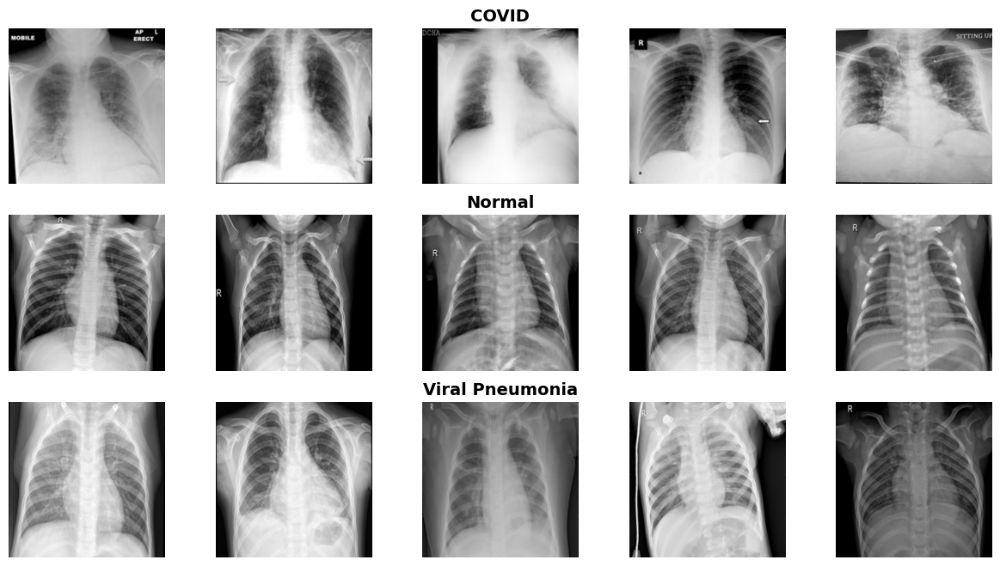

In [22]:
##################################
# Taking a snapshot of the dataset
##################################
n_samples = 5
fig, m_axs = plt.subplots(3, n_samples, figsize = (3*n_samples, 8))
for n_axs, (type_name, type_rows) in zip(m_axs, xray_images.sort_values(['Diagnosis']).groupby('Diagnosis')):
    n_axs[2].set_title(type_name, fontsize = 14, weight = 'bold')
    for c_ax, (_, c_row) in zip(n_axs, type_rows.sample(n_samples, random_state=123).iterrows()):       
        picture = c_row['Path']
        image = cv2.imread(picture)
        c_ax.imshow(image)
        c_ax.axis('off')

In [23]:
##################################
# Sampling a single image
##################################
samples, features = xray_images.shape
plt.figure()
pic_id = random.randrange(0, samples)
picture = xray_images['Path'][pic_id]
image = cv2.imread(picture) 

<Figure size 640x480 with 0 Axes>

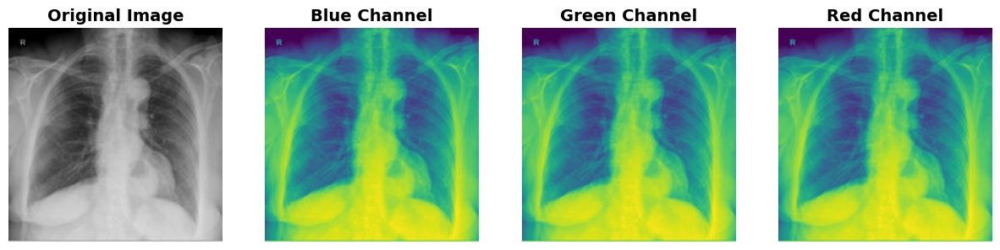

In [24]:
##################################
# Plotting using subplots
##################################
plt.figure(figsize=(15, 5))

##################################
# Formulating the original image
##################################
plt.subplot(1, 4, 1)
plt.imshow(image)
plt.title('Original Image', fontsize = 14, weight = 'bold')
plt.axis('off')

##################################
# Formulating the blue channel
##################################
plt.subplot(1, 4, 2)
plt.imshow(image[ : , : , 0])
plt.title('Blue Channel', fontsize = 14, weight = 'bold')
plt.axis('off')

##################################
# Formulating the green channel
##################################
plt.subplot(1, 4, 3)
plt.imshow(image[ : , : , 1])
plt.title('Green Channel', fontsize = 14, weight = 'bold')
plt.axis('off')

##################################
# Formulating the red channel
##################################
plt.subplot(1, 4, 4)
plt.imshow(image[ : , : , 2])
plt.title('Red Channel', fontsize = 14, weight = 'bold')
plt.axis('off')

##################################
# Consolidating all images
##################################
plt.show()

In [25]:
##################################
# Determining the image shape
##################################
print('Image Shape:')
display(image.shape)

Image Shape:


(299, 299, 3)

In [26]:
##################################
# Determining the image height
##################################
print('Image Height:')
display(image.shape[0])

Image Height:


299

In [27]:
##################################
# Determining the image width
##################################
print('Image Width:')
display(image.shape[1])

Image Width:


299

In [28]:
##################################
# Determining the image dimension
##################################
print('Image Dimension:')
display(image.ndim)

Image Dimension:


3

In [29]:
##################################
# Determining the image size
##################################
print('Image Size:')
display(image.size)

Image Size:


268203

In [30]:
##################################
# Determining the image data type
##################################
print('Image Data Type:')
display(image.dtype)

Image Data Type:


dtype('uint8')

In [31]:
##################################
# Determining the maximum RGB value
##################################
print('Image Maximum RGB:')
display(image.max())

Image Maximum RGB:


219

In [32]:
##################################
# Determining the minimum RGB value
##################################
print('Image Minimum RGB:')
display(image.min())

Image Minimum RGB:


0

#### 1.3.3.2 Image Augmentation <a class="anchor" id="1.3.3.2"></a>

1. Different image augmentation techniques were applied using various transformations to the training images to artificially increase the diversity of the dataset and improve the generalization and robustness of the model, including:
    * 1.1 **Rescaling** - normalization of the pixel values within the 0 to 1 range
    * 1.2 **Rotation** - random image rotation by 5 degrees
    * 1.3 **Width Shift** - random horizontal shifting of the image by 5% of the total width
    * 1.4 **Height Shift** - random vertical shifting of the image by 5% of the total height
    * 1.7 **Shear Transformation** - image slanting by 5 degrees along the horizontal axis.
    * 1.8 **Zooming** - random image zoom-in or zoom-out by a factor of 5%
2. Other image augmentation techniques were not applied to minimize noise in the dataset, including:
    * 1.5 **Horizontal Flip** - random horizontal flipping of the image
    * 1.6 **Vertical Flip** - random vertical flipping of the image

In [33]:
##################################
# Identifying the path for the images
# and defining image categories 
##################################
path = (os.path.join("..", DATASETS_ORIGINAL_PATH))
classes=["COVID", "Normal", "Viral Pneumonia"]
num_classes = len(classes)
batch_size = 16

In [34]:
##################################
# Creating subsets of images
# for model training and
# setting the parameters for
# real-time data augmentation
# at each epoch
##################################
set_seed()
train_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range=5,
                                   width_shift_range=0.05,
                                   height_shift_range=0.05,
                                   horizontal_flip=False,
                                   vertical_flip=False,
                                   shear_range=0.05,
                                   zoom_range=0.05,
                                   validation_split=0.2)


##################################
# Loading the model training images
##################################
train_gen = train_datagen.flow_from_directory(directory=path, 
                                              target_size=(299, 299),
                                              class_mode='categorical',
                                              subset='training',
                                              shuffle=True, 
                                              classes=classes,
                                              batch_size=batch_size, 
                                              color_mode="grayscale")

Found 2880 images belonging to 3 classes.


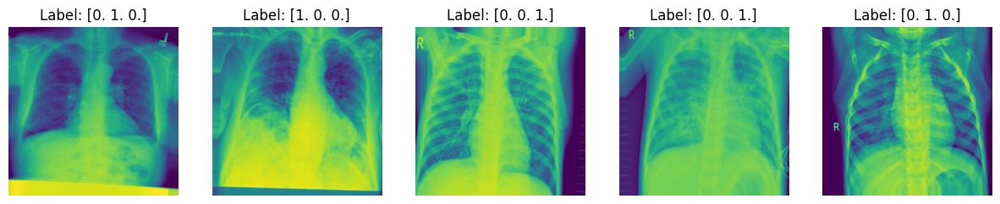

In [35]:
##################################
# Loading samples of augmented images
# for the training set
##################################
##################################
# Loading samples of augmented images
# for the training set
##################################
fig, axes = plt.subplots(1, 5, figsize=(15, 3))

for i in range(5):
    batch = next(train_gen)
    images, labels = batch
    axes[i].imshow(images[0]) 
    axes[i].set_title(f"Label: {labels[0]}")
    axes[i].axis('off')
plt.show()

In [36]:
##################################
# Creating subsets of images
# for model validation
# setting the parameters for
# real-time data augmentation
# at each epoch
##################################
set_seed()
test_datagen = ImageDataGenerator(rescale=1./255, 
                                  validation_split=0.2)

##################################
# Loading the model evaluation images
##################################
test_gen = test_datagen.flow_from_directory(directory=path, 
                                            target_size=(299, 299),
                                            class_mode='categorical',
                                            subset='validation',
                                            shuffle=False, 
                                            classes=classes,
                                            batch_size=batch_size, 
                                            color_mode="grayscale")

Found 720 images belonging to 3 classes.


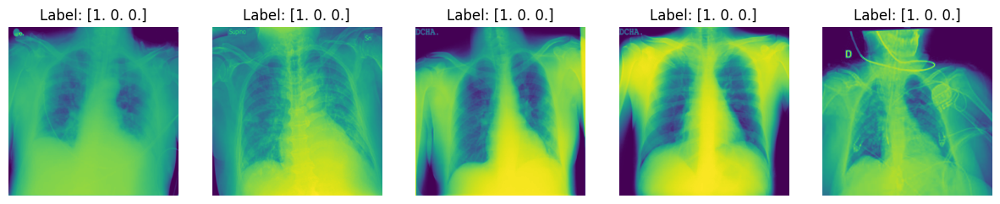

In [37]:
##################################
# Loading samples of original images
# for the validation set
##################################
images, labels = next(test_gen)
fig, axes = plt.subplots(1, 5, figsize=(15, 3))
for i, idx in enumerate(range(0, 5)):
    axes[i].imshow(images[idx])
    axes[i].set_title(f"Label: {labels[0]}")
    axes[i].axis('off')
plt.show()

### 1.3.4. Data Exploration <a class="anchor" id="1.3.4"></a>

#### 1.3.4.1 Exploratory Data Analysis <a class="anchor" id="1.3.4.1"></a>

1. Distinct patterns were observed between the image categories.
    * 1.1 Images identified with <span style="color: #FF0000">CLASS: COVID</span> had the following characteristics:
        * 1.1.1 Higher mean pixel values indicating generally lighter images
        * 1.1.2 Bimodal and wider distribution of maximum pixel values indicating a higher variation in highest possible values
        * 1.1.3 Wider range of image pixel standard deviation indicating a higher variation in contrast
    * 1.2 Images identified with <span style="color: #FF0000">CLASS: Viral Pneumonia</span> had the following characteristics:
        * 1.2.1 Higher mean pixel values indicating generally lighter images
        * 1.2.2 Bimodal and wider distribution of maximum pixel values indicating a higher variation in highest possible values
        * 1.2.3 Wider range of image pixel standard deviation indicating a higher variation in contrast
    * 1.3 Images identified with <span style="color: #FF0000">CLASS: Normal</span> had the following characteristics:
        * 1.3.1 Lower mean pixel values indicating generally darker images
        * 1.3.2 Unimodal and steeper distribution of maximum pixel values indicating more stable highest possible values
        * 1.3.3 Compact range of image pixel standard deviation indicating images with stable and sufficient contrast

In [38]:
##################################
# Consolidating summary statistics
# for the image pixel values
##################################
mean_val = []
std_dev_val = []
max_val = []
min_val = []

for i in range(0, samples):
    mean_val.append(xray_images['Image'][i].mean())
    std_dev_val.append(np.std(xray_images['Image'][i]))
    max_val.append(xray_images['Image'][i].max())
    min_val.append(xray_images['Image'][i].min())

imageEDA = xray_images.loc[:,['Image', 'Class','Path']]
imageEDA['Mean'] = mean_val
imageEDA['StDev'] = std_dev_val
imageEDA['Max'] = max_val
imageEDA['Min'] = min_val

In [39]:
##################################
# Consolidating the overall mean
# for the pixel intensity means
# grouped by categories
##################################
imageEDA.groupby(['Class'])['Mean'].mean()

Class
Covid-19           143.712634
Healthy            122.619439
Viral Pneumonia    125.310461
Name: Mean, dtype: float64

In [40]:
##################################
# Consolidating the overall minimum
# for the pixel intensity means
# grouped by categories
##################################
imageEDA.groupby(['Class'])['Mean'].min()

Class
Covid-19           46.677511
Healthy            73.304356
Viral Pneumonia    64.771022
Name: Mean, dtype: float64

In [41]:
##################################
# Consolidating the overall maximum
# for the pixel intensity means
# grouped by categories
##################################
imageEDA.groupby(['Class'])['Mean'].max()

Class
Covid-19           216.570667
Healthy            175.906667
Viral Pneumonia    179.011911
Name: Mean, dtype: float64

In [42]:
##################################
# Consolidating the overall standard deviation
# for the pixel intensity means
# grouped by categories
##################################
imageEDA.groupby(['Class'])['Mean'].std()

Class
Covid-19           22.160832
Healthy            13.716765
Viral Pneumonia    19.052677
Name: Mean, dtype: float64

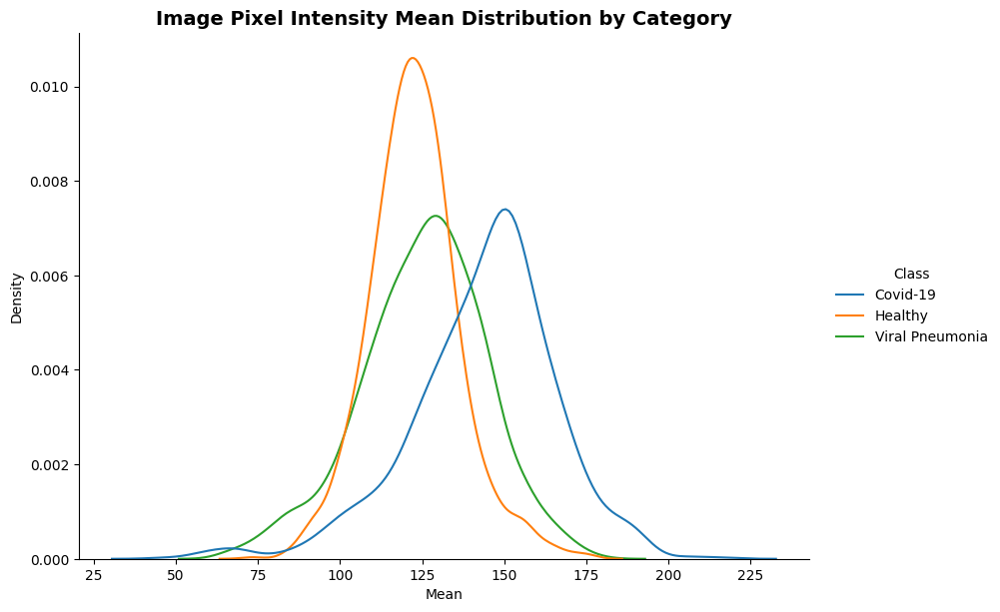

In [43]:
##################################
# Formulating the mean distribution
# by category of the image pixel values
##################################
sns.displot(data = imageEDA, x = 'Mean', kind="kde", hue = 'Class', height=6, aspect=1.40)
plt.title('Image Pixel Intensity Mean Distribution by Category', fontsize=14, weight='bold');

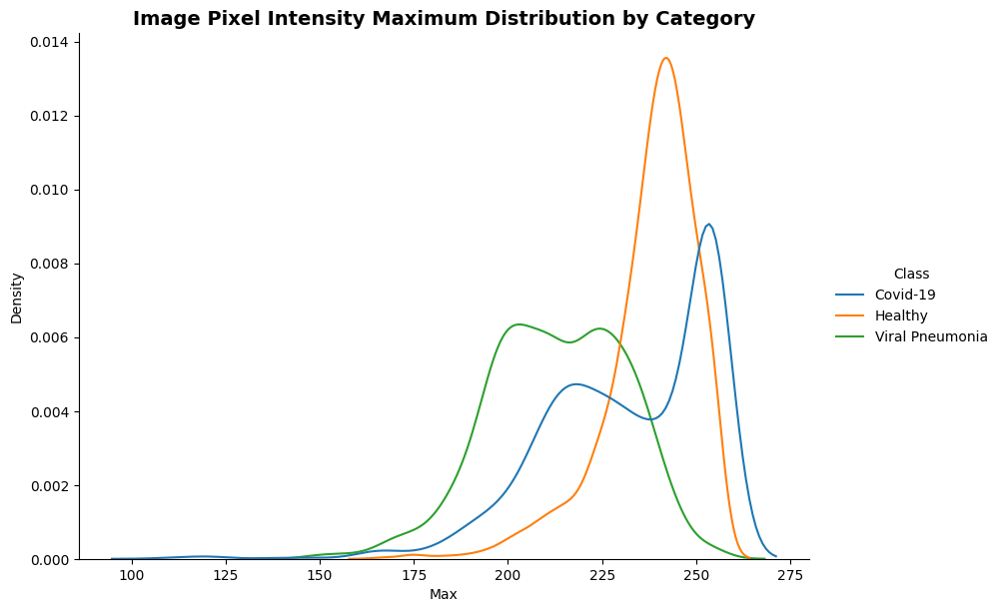

In [44]:
##################################
# Formulating the maximum distribution
# by category of the image pixel values
##################################
sns.displot(data = imageEDA, x = 'Max', kind="kde", hue = 'Class', height=6, aspect=1.40)
plt.title('Image Pixel Intensity Maximum Distribution by Category', fontsize=14, weight='bold');

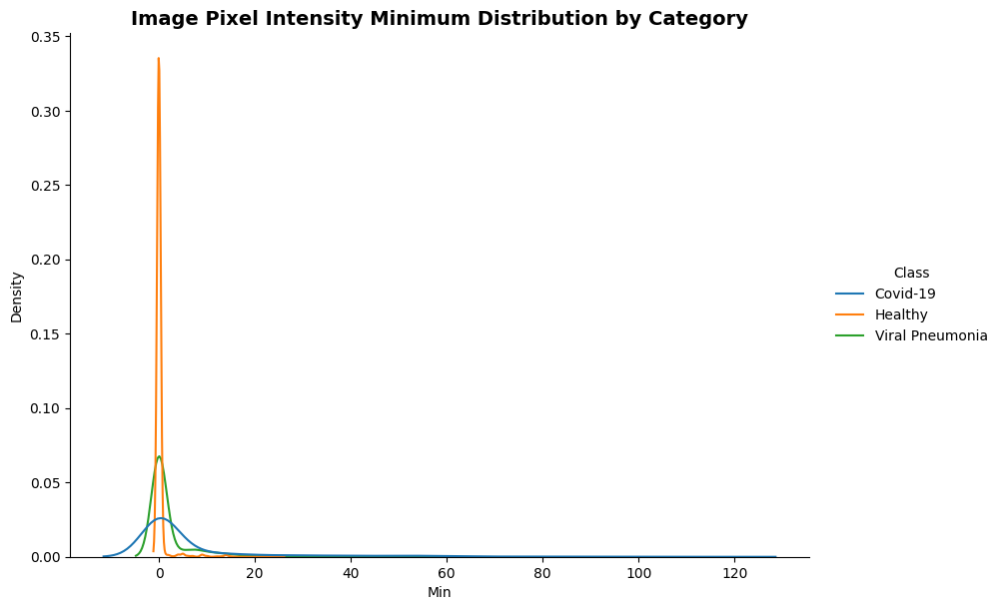

In [45]:
##################################
# Formulating the minimum distribution
# by category of the image pixel values
##################################
sns.displot(data = imageEDA, x = 'Min', kind="kde", hue = 'Class', height=6, aspect=1.40)
plt.title('Image Pixel Intensity Minimum Distribution by Category', fontsize=14, weight='bold');

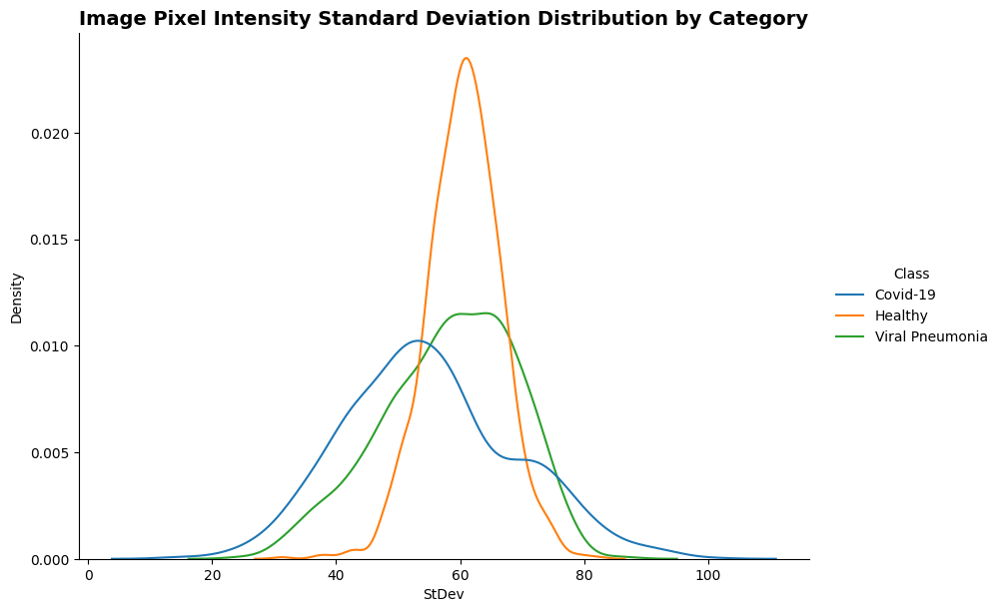

In [46]:
##################################
# Formulating the standard deviation distribution
# by category of the image pixel values
##################################
sns.displot(data = imageEDA, x = 'StDev', kind="kde", hue = 'Class', height=6, aspect=1.40)
plt.title('Image Pixel Intensity Standard Deviation Distribution by Category', fontsize=14, weight='bold');

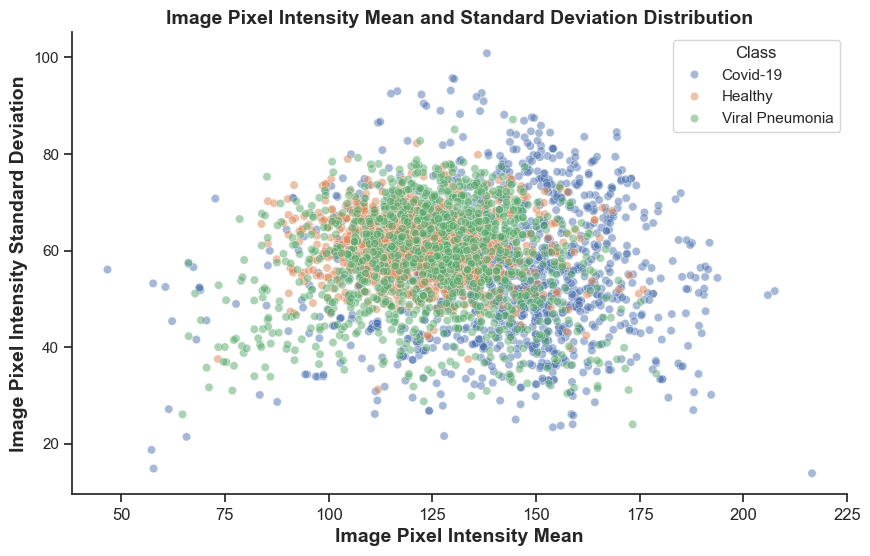

In [47]:
##################################
# Formulating the mean and standard deviation 
# scatterplot distribution
# by category of the image pixel values
##################################
plt.figure(figsize=(10,6))
sns.set(style="ticks", font_scale = 1)
ax = sns.scatterplot(data=imageEDA, x="Mean", y=imageEDA['StDev'], hue='Class', alpha=0.5)
sns.despine(top=True, right=True, left=False, bottom=False)
plt.xticks(rotation=0, fontsize = 12)
ax.set_xlabel('Image Pixel Intensity Mean',fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
plt.title('Image Pixel Intensity Mean and Standard Deviation Distribution', fontsize = 14, weight='bold');

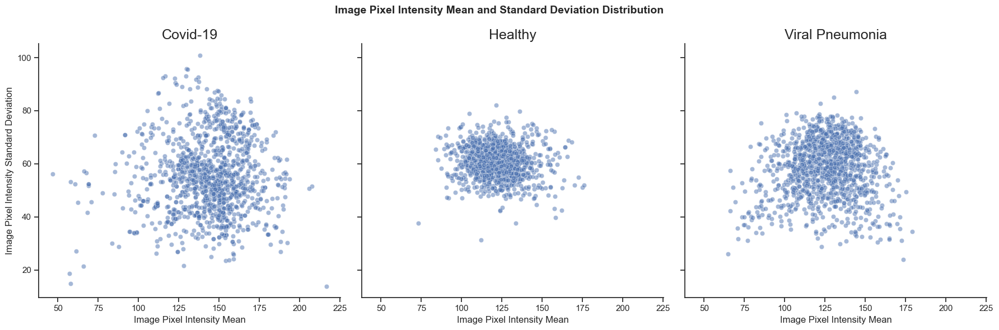

In [48]:
##################################
# Formulating the mean and standard deviation 
# scatterplot distribution
# by category of the image pixel values
##################################
scatterplot = sns.FacetGrid(imageEDA, col="Class", height=6)
scatterplot.map_dataframe(sns.scatterplot, x='Mean', y='StDev', alpha=0.5)
scatterplot.set_titles(col_template="{col_name}", row_template="{row_name}", size=18)
scatterplot.fig.subplots_adjust(top=.8)
scatterplot.fig.suptitle('Image Pixel Intensity Mean and Standard Deviation Distribution', fontsize=14, weight='bold')
axes = scatterplot.axes.flatten()
axes[0].set_ylabel('Image Pixel Intensity Standard Deviation')
for ax in axes:
    ax.set_xlabel('Image Pixel Intensity Mean')
scatterplot.fig.tight_layout()

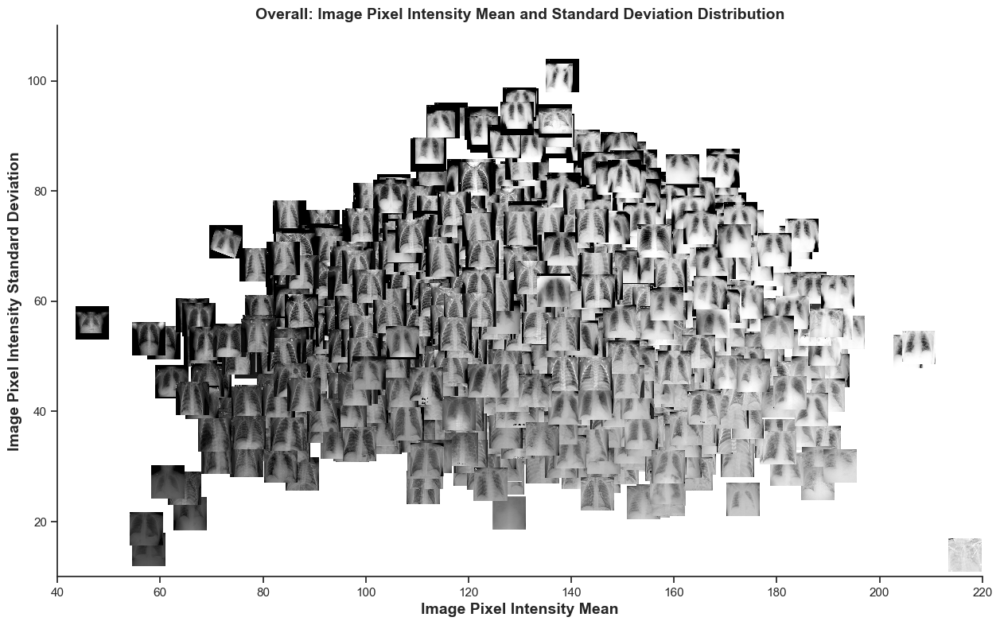

In [49]:
##################################
# Formulating the mean and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
##################################
def getImage(path):
    return OffsetImage(cv2.imread(path),zoom = 0.1)

DF_sample = imageEDA.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Mean", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Mean', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(40,220)
ax.set_ylim(10,110)
plt.title('Overall: Image Pixel Intensity Mean and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Mean'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

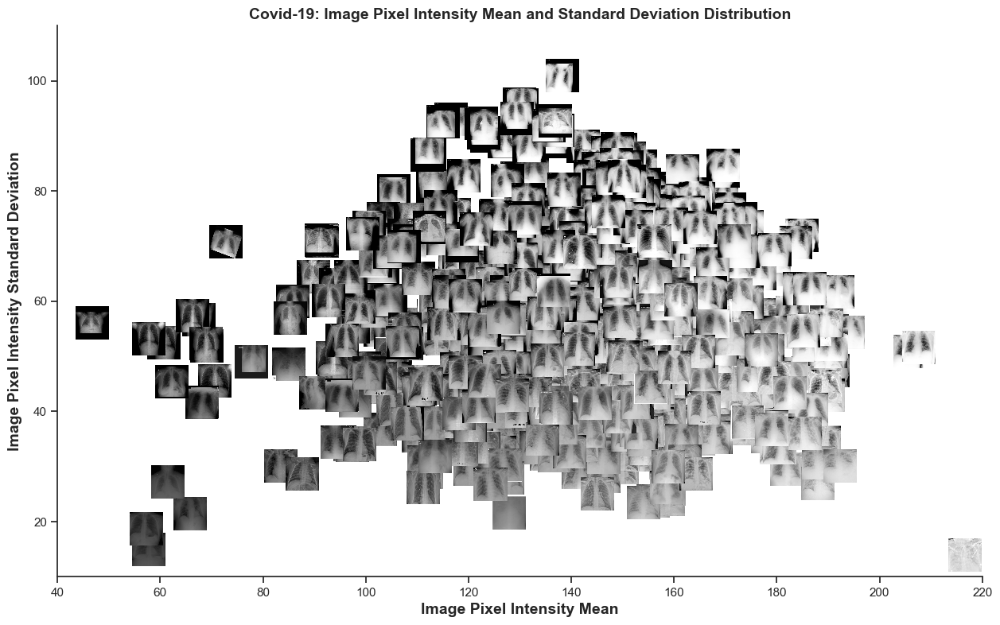

In [50]:
##################################
# Formulating the mean and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Covid-19 class
##################################
path_covid = (os.path.join("..", DATASETS_ORIGINAL_PATH,'COVID/'))
imageEDA_covid = imageEDA.loc[imageEDA['Class'] == 'Covid-19']

DF_sample = imageEDA_covid.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Mean", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Mean', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(40,220)
ax.set_ylim(10,110)
plt.title('Covid-19: Image Pixel Intensity Mean and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path_covid in zip(DF_sample['Mean'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path_covid), (x0, y0), frameon=False)
    ax.add_artist(ab)

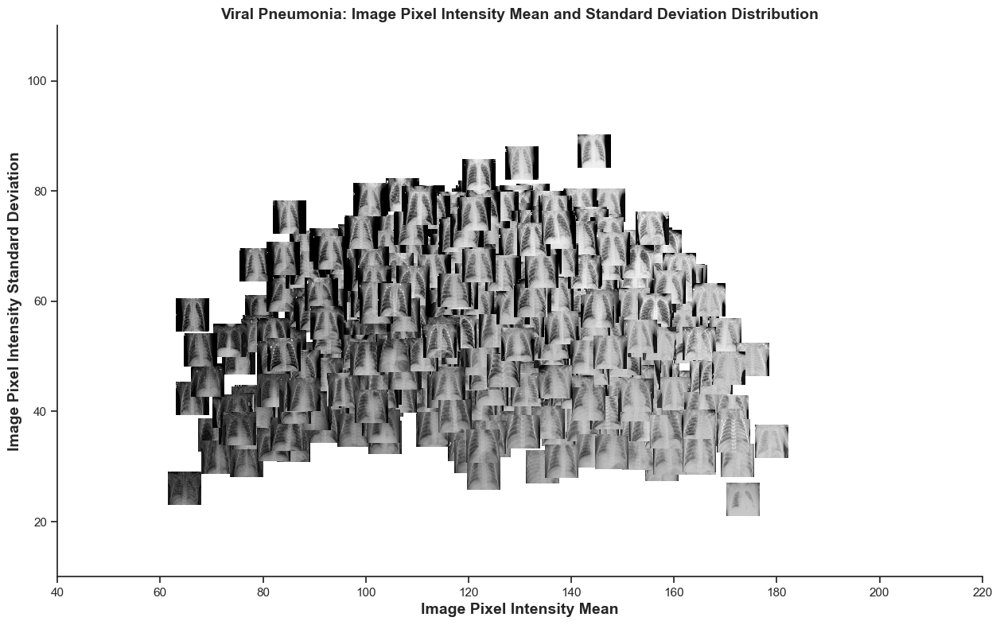

In [51]:
##################################
# Formulating the mean and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Viral Pneumonia class
##################################
path_viral_pneumonia = (os.path.join("..", DATASETS_ORIGINAL_PATH,'Viral Pneumonia/'))
imageEDA_viral_pneumonia = imageEDA.loc[imageEDA['Class'] == 'Viral Pneumonia']

DF_sample = imageEDA_viral_pneumonia.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Mean", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Mean', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(40,220)
ax.set_ylim(10,110)
plt.title('Viral Pneumonia: Image Pixel Intensity Mean and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path_viral_pneumonia in zip(DF_sample['Mean'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path_viral_pneumonia), (x0, y0), frameon=False)
    ax.add_artist(ab)

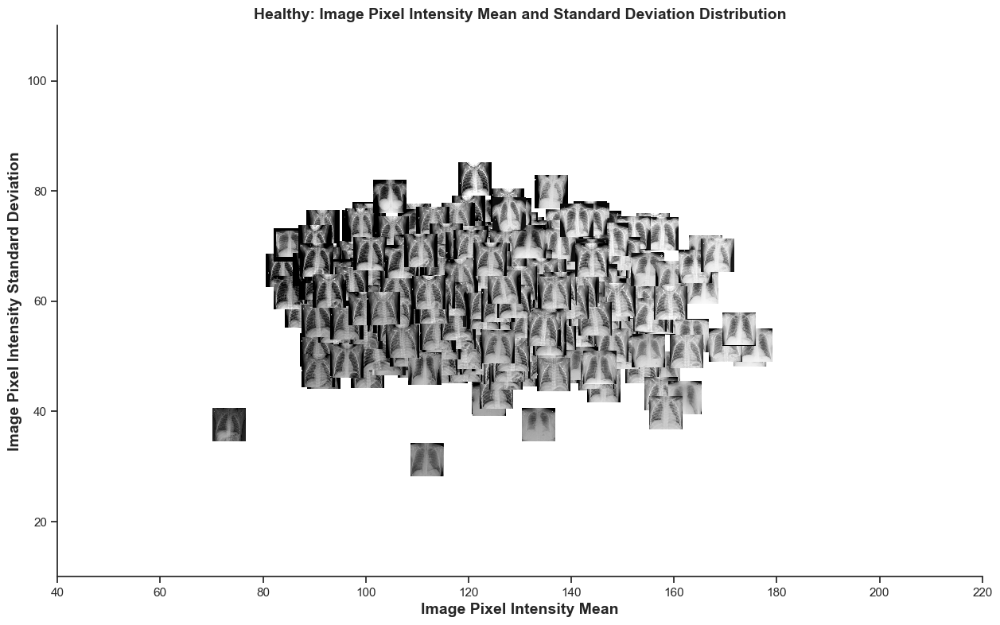

In [52]:
##################################
# Formulating the mean and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Normal class
##################################
path_normal = (os.path.join("..", DATASETS_ORIGINAL_PATH,'Normal/'))
imageEDA_normal = imageEDA.loc[imageEDA['Class'] == 'Healthy']

DF_sample = imageEDA_normal.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Mean", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Mean', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(40,220)
ax.set_ylim(10,110)
plt.title('Healthy: Image Pixel Intensity Mean and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path_normal in zip(DF_sample['Mean'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path_normal), (x0, y0), frameon=False)
    ax.add_artist(ab)

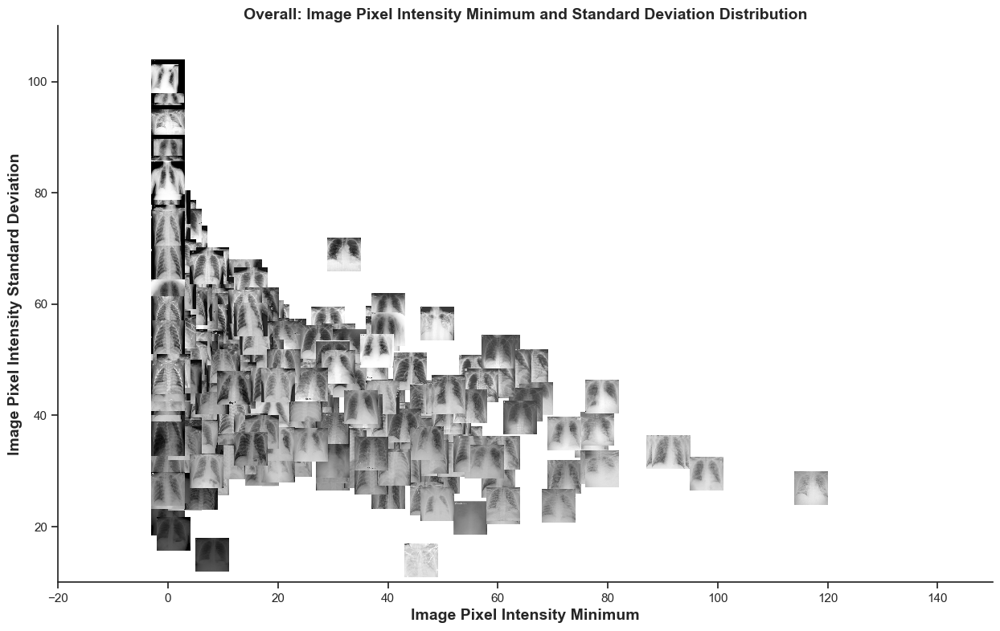

In [53]:
##################################
# Formulating the minimum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
##################################
DF_sample = imageEDA.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Min", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Minimum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(-20,150)
ax.set_ylim(10,110)
plt.title('Overall: Image Pixel Intensity Minimum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Min'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

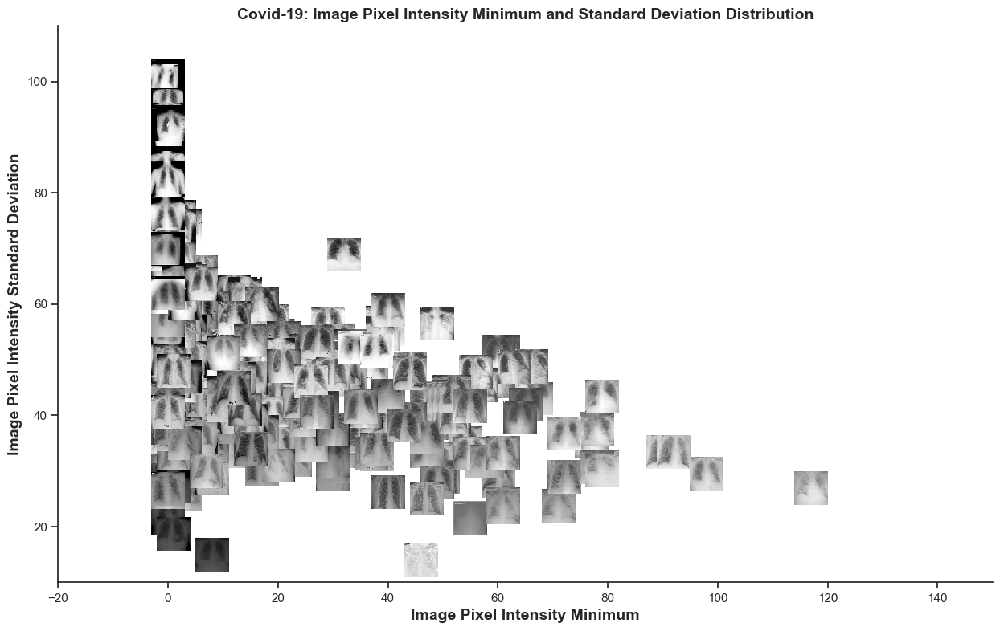

In [54]:
##################################
# Formulating the minimum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Covid-19 class
##################################
path_covid = (os.path.join("..", DATASETS_ORIGINAL_PATH,'COVID/'))
imageEDA_covid = imageEDA.loc[imageEDA['Class'] == 'Covid-19']

DF_sample = imageEDA_covid.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Min", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Minimum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(-20,150)
ax.set_ylim(10,110)
plt.title('Covid-19: Image Pixel Intensity Minimum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Min'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

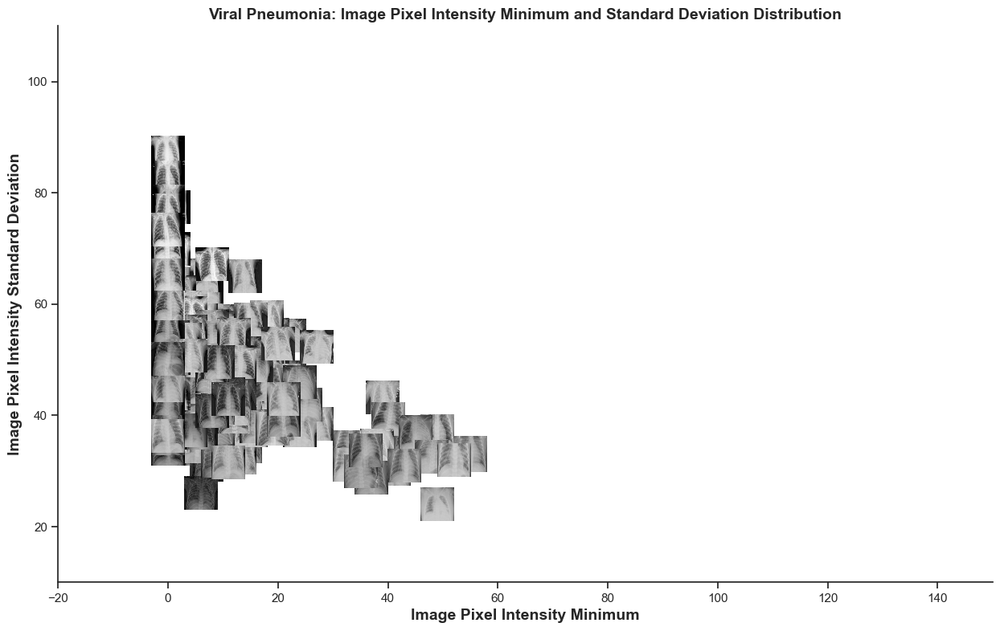

In [55]:
##################################
# Formulating the minimum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Viral Pneumonia class
##################################
path_viral_pneumonia = (os.path.join("..", DATASETS_ORIGINAL_PATH,'Viral Pneumonia/'))
imageEDA_viral_pneumonia = imageEDA.loc[imageEDA['Class'] == 'Viral Pneumonia']

DF_sample = imageEDA_viral_pneumonia.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Min", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Minimum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(-20,150)
ax.set_ylim(10,110)
plt.title('Viral Pneumonia: Image Pixel Intensity Minimum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Min'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

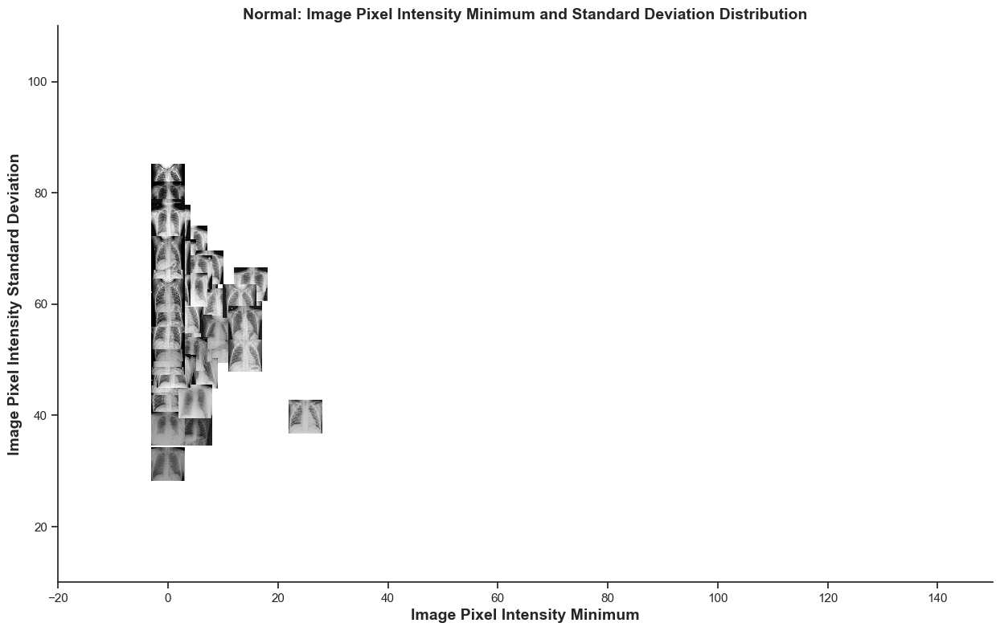

In [56]:
##################################
# Formulating the minimum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Normal class
##################################
path_normal = (os.path.join("..", DATASETS_ORIGINAL_PATH,'Normal/'))
imageEDA_normal = imageEDA.loc[imageEDA['Class'] == 'Healthy']

DF_sample = imageEDA_normal.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Min", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Minimum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(-20,150)
ax.set_ylim(10,110)
plt.title('Normal: Image Pixel Intensity Minimum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Min'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

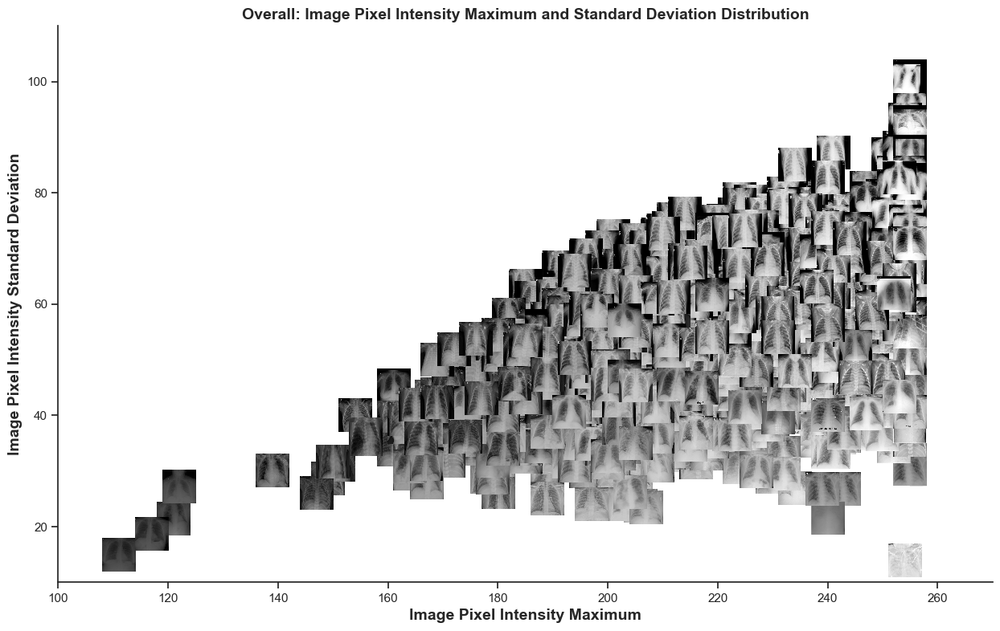

In [57]:
##################################
# Formulating the maximum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
##################################
def getImage(path):
    return OffsetImage(cv2.imread(path),zoom = 0.1)

DF_sample = imageEDA.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Max", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Maximum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(100,270)
ax.set_ylim(10,110)
plt.title('Overall: Image Pixel Intensity Maximum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Max'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

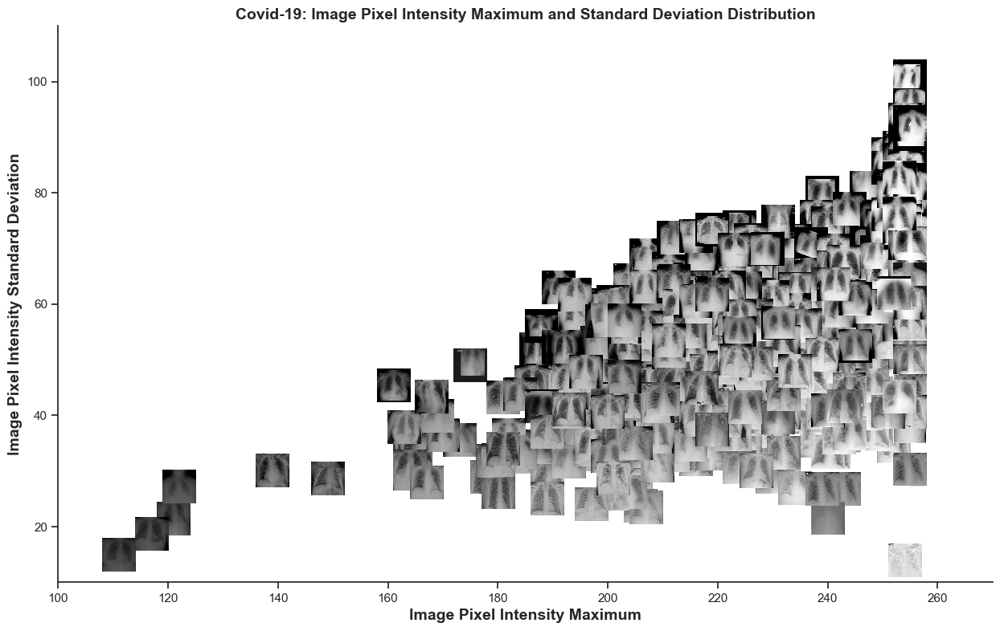

In [58]:
##################################
# Formulating the maximum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Covid-19 class
##################################
path_covid = (os.path.join("..", DATASETS_ORIGINAL_PATH,'COVID/'))
imageEDA_covid = imageEDA.loc[imageEDA['Class'] == 'Covid-19']

DF_sample = imageEDA_covid.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Max", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Maximum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(100,270)
ax.set_ylim(10,110)
plt.title('Covid-19: Image Pixel Intensity Maximum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Max'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

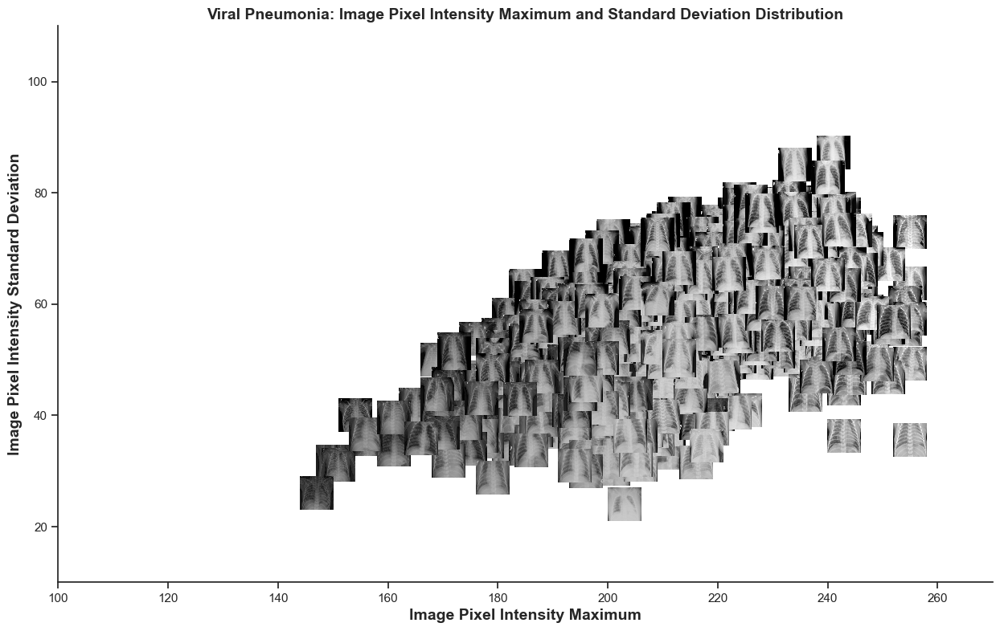

In [59]:
##################################
# Formulating the minimum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Viral Pneumonia class
##################################
path_viral_pneumonia = (os.path.join("..", DATASETS_ORIGINAL_PATH,'Viral Pneumonia/'))
imageEDA_viral_pneumonia = imageEDA.loc[imageEDA['Class'] == 'Viral Pneumonia']

DF_sample = imageEDA_viral_pneumonia.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Max", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Maximum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(100,270)
ax.set_ylim(10,110)
plt.title('Viral Pneumonia: Image Pixel Intensity Maximum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Max'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

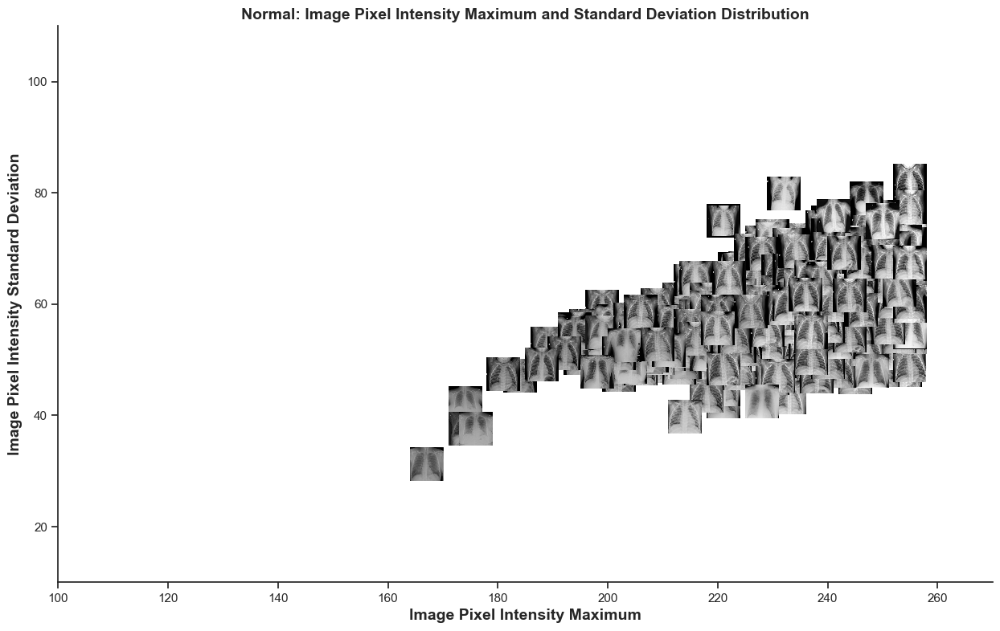

In [60]:
##################################
# Formulating the maximum and standard deviation 
# scatterplot distribution
# of the image pixel values
# represented as actual images
# for the Normal class
##################################
path_normal = (os.path.join("..", DATASETS_ORIGINAL_PATH,'Normal/'))
imageEDA_normal = imageEDA.loc[imageEDA['Class'] == 'Healthy']

DF_sample = imageEDA_normal.sample(frac=1.0, replace=False, random_state=123)
paths = DF_sample['Path']

fig, ax = plt.subplots(figsize=(15,9))
ab = sns.scatterplot(data=DF_sample, x="Max", y='StDev')
sns.despine(top=True, right=True, left=False, bottom=False)
ax.set_xlabel('Image Pixel Intensity Maximum', fontsize=14, weight='bold')
ax.set_ylabel('Image Pixel Intensity Standard Deviation', fontsize=14, weight='bold')
ax.set_xlim(100,270)
ax.set_ylim(10,110)
plt.title('Normal: Image Pixel Intensity Maximum and Standard Deviation Distribution', fontsize=14, weight='bold');

for x0, y0, path in zip(DF_sample['Max'], DF_sample['StDev'],paths):
    ab = AnnotationBbox(getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)

### 1.3.5 Model Development <a class="anchor" id="1.3.5"></a>

#### 1.3.5.1 Premodelling Data Description <a class="anchor" id="1.3.5.1"></a>

1. Training data included **2880 augmented images** representing 80% of the dataset.
2. Validation data included **720 original images** representing 20% of the dataset.
3. Candidate models were formulated using common layers as follows:
    * 3.1 **Convolutional Layer** - extracts features from input images using convolutional filters
    * 3.2 **Maximum Pooling Layer** - Reduces spatial dimensions and downsamples feature maps
    * 3.3 **Activation Layer** - Applies an activation function element-wise to the output
    * 3.4 **Flatten Layer** - Flattens the input to a 1D array, preparing for fully connected layers
    * 3.5 **Dense Layer** - Fully connected layer for classification
4. Different iterations of the model were formulated using variations in the inclusion or exclusion of the following regularization layers:
    * 4.1 **Dropout Layer** - randomly drops (sets to zero) a fraction of the neurons during training reducing co-dependencies between them
    * 4.2 **Batch Normalization Layer** - adjusts and scales the inputs to a layer reducing the sensitivity to weight initialization choices
5. A subset of hyperparameters for the different layers were fixed during model training including:
    * 5.1 **Filters** - setting used to capture spatial hierarchies and features in the input images
    * 5.2 **Kernel Size** - setting used to define the local region the convolutional layer considers when processing the input
    * 5.3 **Activation** - setting used to introduce non-linearity into the model, enabling it to learn complex relationships in the data
    * 5.4 **Pool Size** - setting used to reduce the spatial dimensions of the feature maps to focus on the most important features
    * 5.5 **Padding** - setting used to control the spatial size and shape for every convolutional operation at each stage
    * 5.6 **Dense Units** - setting used to process the flattened feature maps and determine the dimensionality of the output space
    * 5.7 **Optimizer** - setting used to determine how the model's weights are updated during training
    * 5.8 **Learning Rate** - setting used to determine the step size at each iteration during optimization
    * 5.9 **Batch Size** - setting used to determine how many samples are used in each iteration of training
    * 5.10 **Loss** - setting used to define the objective that the model seeks to minimize during training

#### 1.3.5.2 CNN With No Regularization <a class="anchor" id="1.3.5.2"></a>
          
1. The [convolutional neural network model](https://www.tensorflow.org/api_docs/python/tf/keras/models) from the <mark style="background-color: #CCECFF"><b>keras.models</b></mark> Python library API was implemented. 
2. The model contains 7 layers with fixed hyperparameters as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * <span style="color: #FF0000">filters</span> = 32
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
        * <span style="color: #FF0000">input_shape</span> = 299x299x1
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * <span style="color: #FF0000">filters</span> = 64
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Flatten: flatten</span>
    * <span style="color: #FF0000">Dense: dense</span>
        * <span style="color: #FF0000">units</span> = 128
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
    * <span style="color: #FF0000">Dense: dense_1</span>
        * <span style="color: #FF0000">units</span> = 3
        * <span style="color: #FF0000">activation</span> = softmax
3. Additional fixed hyperparameters used during model compilation are as follows:
    * <span style="color: #FF0000">loss</span> = categorical_crossentropy
    * <span style="color: #FF0000">optimizer</span> = adam (adaptive moment estimation)
    * <span style="color: #FF0000">metrics</span> = recall
4. The model contained 44,878,723 trainable parameters broken down per layer as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * output size = 299x299x32
        * number of parameters = 320
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * output size = 149x149x32
        * number of parameters = 0
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * output size = 149x149x64
        * number of parameters = 18496 
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * output size = 74x74x64
        * number of parameters = 0
    * <span style="color: #FF0000">Flatten: flatten</span>
        * output size = 350464
        * number of parameters = 0
    * <span style="color: #FF0000">Dense: dense</span>
        * output size = 128
        * number of parameters = 44859520
    * <span style="color: #FF0000">Dense: dense_1</span>
        * output size = 3
        * number of parameters = 387
5. The model performance on the validation set for all image categories is summarized as follows:
    * **Precision** = 0.9202
    * **Recall** = 0.9125
    * **F1 Score** = 0.9129

In [61]:
##################################
# Defining a function for
# plotting the loss profile
# of the training and validation sets
#################################
def plot_training_history(history, model_name):
    plt.figure(figsize=(10,6))
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Validation')
    plt.title(f'{model_name} Training Loss', fontsize = 16, weight = 'bold', pad=20)
    plt.ylim(0, 5)
    plt.xlabel('Epoch', fontsize = 14, weight = 'bold',)
    plt.ylabel('Loss', fontsize = 14, weight = 'bold',)
    plt.legend(loc='upper right')
    plt.show()

In [62]:
##################################
# Formulating the network architecture
# for CNN with no regularization
##################################
set_seed()
batch_size = 16
model_nr = Sequential()
model_nr.add(Conv2D(filters=32, kernel_size=(3, 3), activation='relu', padding='Same', input_shape=(299, 299, 1)))
model_nr.add(MaxPooling2D(pool_size=(2, 2)))
model_nr.add(Conv2D(filters=64, kernel_size=(3, 3), padding='Same', activation='relu'))
model_nr.add(MaxPooling2D(pool_size=(2, 2)))
model_nr.add(Flatten())
model_nr.add(Dense(units=128, activation='relu'))
model_nr.add(Dense(units=num_classes, activation='softmax'))

##################################
# Compiling the network layers
##################################
model_nr.compile(loss='categorical_crossentropy', optimizer='adam', metrics=[Recall()])

In [63]:
##################################
# Displaying the model summary
# for CNN with no regularization
##################################
print(model_nr.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 299, 299, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 149, 149, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 149, 149, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 74, 74, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 350464)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      44,859,520 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 3)                   │             387 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 44,878,723 (171.20 MB)

 Trainable params: 44,878,723 (171.20 MB)

 Non-trainable params: 0 (0.00 B)

None


In [64]:
##################################
# Displaying the model layers
# for CNN with no regularization
##################################
model_nr_layer_names = [layer.name for layer in model_nr.layers]
print("Layer Names:", model_nr_layer_names)

Layer Names: ['conv2d', 'max_pooling2d', 'conv2d_1', 'max_pooling2d_1', 'flatten', 'dense', 'dense_1']


In [65]:
##################################
# Displaying the number of weights
# for each model layer
# for CNN with no regularization
##################################
for layer in model_nr.layers:
    if hasattr(layer, 'weights'):
        print(f"Layer: {layer.name}, Number of Weights: {len(layer.get_weights())}")

Layer: conv2d, Number of Weights: 2
Layer: max_pooling2d, Number of Weights: 0
Layer: conv2d_1, Number of Weights: 2
Layer: max_pooling2d_1, Number of Weights: 0
Layer: flatten, Number of Weights: 0
Layer: dense, Number of Weights: 2
Layer: dense_1, Number of Weights: 2


In [66]:
##################################
# Displaying the number of weights
# for each model layer
# for CNN with no regularization
##################################
total_parameters = 0
for layer in model_nr.layers:
    layer_parameters = layer.count_params()
    total_parameters += layer_parameters
    print(f"Layer: {layer.name}, Parameters: {layer_parameters}")
print("\nTotal Parameters in the Model:", total_parameters)

Layer: conv2d, Parameters: 320
Layer: max_pooling2d, Parameters: 0
Layer: conv2d_1, Parameters: 18496
Layer: max_pooling2d_1, Parameters: 0
Layer: flatten, Parameters: 0
Layer: dense, Parameters: 44859520
Layer: dense_1, Parameters: 387

Total Parameters in the Model: 44878723


In [67]:
##################################
# Fitting the model
# for CNN with no regularization
##################################
epochs = 100
set_seed()
model_nr_history = model_nr.fit(train_gen, 
                                steps_per_epoch=len(train_gen) // batch_size,   
                                validation_steps=len(test_gen) // batch_size, 
                                validation_data=test_gen, 
                                epochs=epochs,
                                verbose=0)

In [68]:
##################################
# Evaluating the model
# for CNN with no regularization
# on the independent validation set
##################################
model_nr_y_pred = model_nr.predict(test_gen)

45/45 ━━━━━━━━━━━━━━━━━━━━ 6s 125ms/step


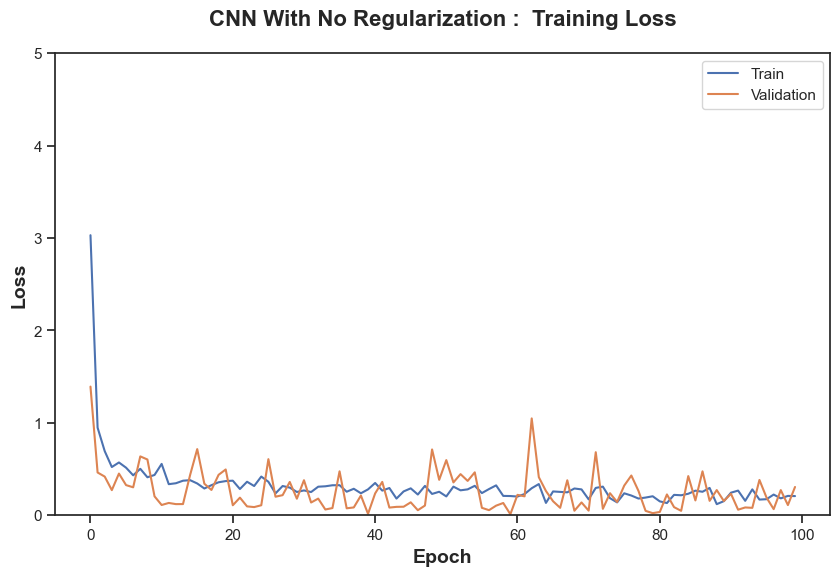

In [69]:
##################################
# Plotting the loss profile
# for CNN with no regularization
# on the training and validation sets
##################################
plot_training_history(model_nr_history, 'CNN With No Regularization : ')

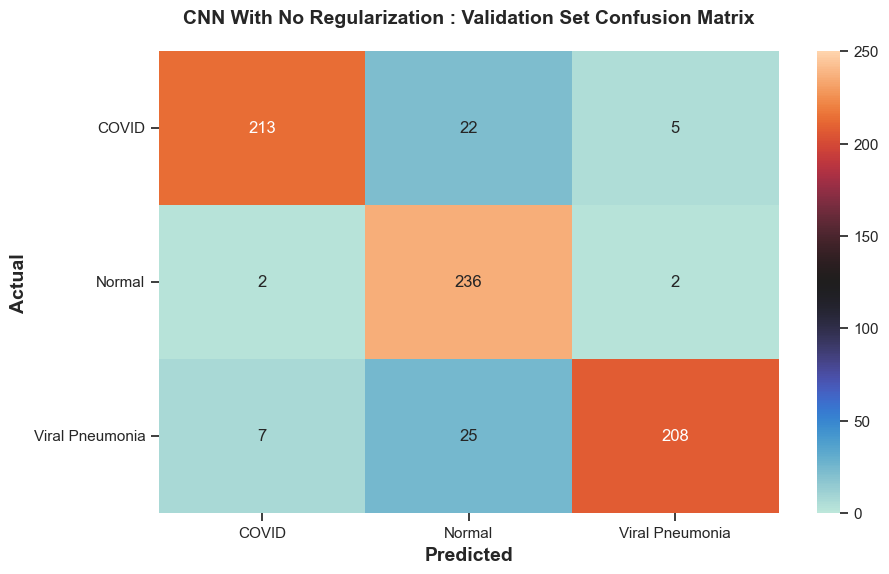

In [70]:
##################################
# Consolidating the predictions
# for CNN with no regularization
# on the validation set
##################################
model_nr_predictions = np.array(list(map(lambda x: np.argmax(x), model_nr_y_pred)))
model_nr_y_true = test_gen.classes

##################################
# Formulating the confusion matrix
# for CNN with no regularization
# on the validation set
##################################
CMatrix = pd.DataFrame(confusion_matrix(model_nr_y_true, model_nr_predictions), columns=classes, index =classes)

##################################
# Plotting the confusion matrix
# for CNN with no regularization
# on the validation set
##################################
plt.figure(figsize=(10, 6))
ax = sns.heatmap(CMatrix, annot = True, fmt = 'g' ,vmin = 0, vmax = 250,cmap = 'icefire')
ax.set_xlabel('Predicted',fontsize = 14,weight = 'bold')
ax.set_xticklabels(ax.get_xticklabels(),rotation =0)
ax.set_ylabel('Actual',fontsize = 14,weight = 'bold') 
ax.set_yticklabels(ax.get_yticklabels(),rotation =0)
ax.set_title('CNN With No Regularization : Validation Set Confusion Matrix',fontsize = 14, weight = 'bold',pad=20);

##################################
# Resetting all states generated by Keras
##################################
keras.backend.clear_session()

In [71]:
##################################
# Calculating the model accuracy
# for CNN with no regularization
# for the entire validation set
##################################
model_nr_acc = accuracy_score(model_nr_y_true, model_nr_predictions)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with no regularization
# for the entire validation set
##################################
model_nr_results_all = precision_recall_fscore_support(model_nr_y_true, model_nr_predictions, average='macro',zero_division = 1)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with no regularization
# for each category of the validation set
##################################
model_nr_results_class = precision_recall_fscore_support(model_nr_y_true, model_nr_predictions, average=None, zero_division = 1)

##################################
# Consolidating all model evaluation metrics 
# for CNN with no regularization
##################################
metric_columns = ['Precision','Recall','F-Score','Support']
model_nr_all_df = pd.concat([pd.DataFrame(list(model_nr_results_class)).T,pd.DataFrame(list(model_nr_results_all)).T])
model_nr_all_df.columns = metric_columns
model_nr_all_df.index = ['COVID', 'Normal', 'Viral Pneumonia','Total']
model_nr_all_df

,Precision,Recall,F-Score,Support
COVID,0.959459,0.887500,0.922078,240.0
Normal,0.833922,0.983333,0.902486,240.0
Viral Pneumonia,0.967442,0.866667,0.914286,240.0
Total,0.920275,0.912500,0.912950,NaN


In [72]:
##################################
# Consolidating all model evaluation metrics 
# for CNN with no regularization
##################################
model_nr_model_list = []
model_nr_measure_list = []
model_nr_category_list = []
model_nr_value_list = []

for i in range(3): 
    for j in range(4):
        model_nr_model_list.append('CNN_NR')
        model_nr_measure_list.append(metric_columns[i])
        model_nr_category_list.append(model_nr_all_df.index[j])
        model_nr_value_list.append(model_nr_all_df.iloc[j,i])

model_nr_all_summary = pd.DataFrame(zip(model_nr_model_list,
                                        model_nr_measure_list,
                                        model_nr_category_list,
                                        model_nr_value_list), 
                                        columns=['CNN.Model.Name',
                                                 'Model.Metric',
                                                 'Image.Category',
                                                 'Metric.Value'])

#### 1.3.5.3 CNN With Dropout Regularization <a class="anchor" id="1.3.5.3"></a>

1. The [convolutional neural network model](https://www.tensorflow.org/api_docs/python/tf/keras/models) from the <mark style="background-color: #CCECFF"><b>keras.models</b></mark> Python library API was implemented. 
2. The model contains 8 layers with fixed hyperparameters as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * <span style="color: #FF0000">filters</span> = 32
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
        * <span style="color: #FF0000">input_shape</span> = 299x299x1
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * <span style="color: #FF0000">filters</span> = 64
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
    * <span style="color: #FF0000">Dropout: dropout</span>
        * <span style="color: #FF0000">rate</span> = 0.25
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Flatten: flatten</span>
    * <span style="color: #FF0000">Dense: dense</span>
        * <span style="color: #FF0000">units</span> = 128
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
    * <span style="color: #FF0000">Dense: dense_1</span>
        * <span style="color: #FF0000">units</span> = 3
        * <span style="color: #FF0000">activation</span> = softmax
3. Additional fixed hyperparameters used during model compilation are as follows:
    * <span style="color: #FF0000">loss</span> = categorical_crossentropy
    * <span style="color: #FF0000">optimizer</span> = adam (adaptive moment estimation)
    * <span style="color: #FF0000">metrics</span> = recall
4. The model contained 44,878,723 trainable parameters broken down per layer as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * output size = 299x299x32
        * number of parameters = 320
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * output size = 149x149x32
        * number of parameters = 0
    * <span style="color: #FF0000">Dropout: dropout</span>
        * output size = 149x149x64
        * number of parameters = 0 
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * output size = 149x149x64
        * number of parameters = 18496 
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * output size = 74x74x64
        * number of parameters = 0
    * <span style="color: #FF0000">Flatten: flatten</span>
        * output size = 350464
        * number of parameters = 0
    * <span style="color: #FF0000">Dense: dense</span>
        * output size = 128
        * number of parameters = 44859520
    * <span style="color: #FF0000">Dense: dense_1</span>
        * output size = 3
        * number of parameters = 387
5. The model performance on the validation set for all image categories is summarized as follows:
    * **Precision** = 0.9242
    * **Recall** = 0.9208
    * **F1 Score** = 0.9210

In [73]:
##################################
# Formulating the network architecture
# for CNN with dropout regularization
##################################
set_seed()
batch_size = 16
input_shape = (299, 299, 1)
model_dr = Sequential()
model_dr.add(Conv2D(filters=32, kernel_size=(3, 3), activation='relu', padding='Same', input_shape=(299, 299, 1)))
model_dr.add(MaxPooling2D(pool_size=(2, 2)))
model_dr.add(Conv2D(filters=64, kernel_size=(3, 3), padding = 'Same', activation='relu'))
model_dr.add(Dropout(rate=0.25))
model_dr.add(MaxPooling2D(pool_size=(2, 2)))
model_dr.add(Flatten())
model_dr.add(Dense(units=128, activation='relu'))
model_dr.add(Dense(units=num_classes, activation='softmax'))

##################################
# Compiling the network layers
##################################
model_dr.compile(loss='categorical_crossentropy', optimizer='adam', metrics=[Recall()])

In [74]:
##################################
# Displaying the model summary
# for CNN with dropout regularization
##################################
print(model_dr.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 299, 299, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 149, 149, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 149, 149, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 149, 149, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 74, 74, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 350464)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      44,859,520 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 3)                   │             387 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 44,878,723 (171.20 MB)

 Trainable params: 44,878,723 (171.20 MB)

 Non-trainable params: 0 (0.00 B)

None


In [75]:
##################################
# Displaying the model layers
# for CNN with dropout regularization
##################################
model_dr_layer_names = [layer.name for layer in model_dr.layers]
print("Layer Names:", model_dr_layer_names)

Layer Names: ['conv2d', 'max_pooling2d', 'conv2d_1', 'dropout', 'max_pooling2d_1', 'flatten', 'dense', 'dense_1']


In [76]:
##################################
# Displaying the number of weights
# for each model layer
# for CNN with dropout regularization
##################################
for layer in model_dr.layers:
    if hasattr(layer, 'weights'):
        print(f"Layer: {layer.name}, Number of Weights: {len(layer.get_weights())}")

Layer: conv2d, Number of Weights: 2
Layer: max_pooling2d, Number of Weights: 0
Layer: conv2d_1, Number of Weights: 2
Layer: dropout, Number of Weights: 0
Layer: max_pooling2d_1, Number of Weights: 0
Layer: flatten, Number of Weights: 0
Layer: dense, Number of Weights: 2
Layer: dense_1, Number of Weights: 2


In [77]:
##################################
# Displaying the number of weights
# for each model layer
# for CNN with dropout regularization
##################################
total_parameters = 0
for layer in model_dr.layers:
    layer_parameters = layer.count_params()
    total_parameters += layer_parameters
    print(f"Layer: {layer.name}, Parameters: {layer_parameters}")
print("\nTotal Parameters in the Model:", total_parameters)

Layer: conv2d, Parameters: 320
Layer: max_pooling2d, Parameters: 0
Layer: conv2d_1, Parameters: 18496
Layer: dropout, Parameters: 0
Layer: max_pooling2d_1, Parameters: 0
Layer: flatten, Parameters: 0
Layer: dense, Parameters: 44859520
Layer: dense_1, Parameters: 387

Total Parameters in the Model: 44878723


In [78]:
##################################
# Fitting the model
# for CNN with dropout regularization
##################################
epochs = 100
set_seed()
model_dr_history = model_dr.fit(train_gen, 
                                steps_per_epoch=len(train_gen) // batch_size,   
                                validation_steps=len(test_gen) // batch_size, 
                                validation_data=test_gen, 
                                epochs=epochs,
                                verbose=0)

In [79]:
##################################
# Evaluating the model
# for CNN with dropout regularization
# on the independent validation set
##################################
model_dr_y_pred = model_dr.predict(test_gen)

45/45 ━━━━━━━━━━━━━━━━━━━━ 6s 124ms/step


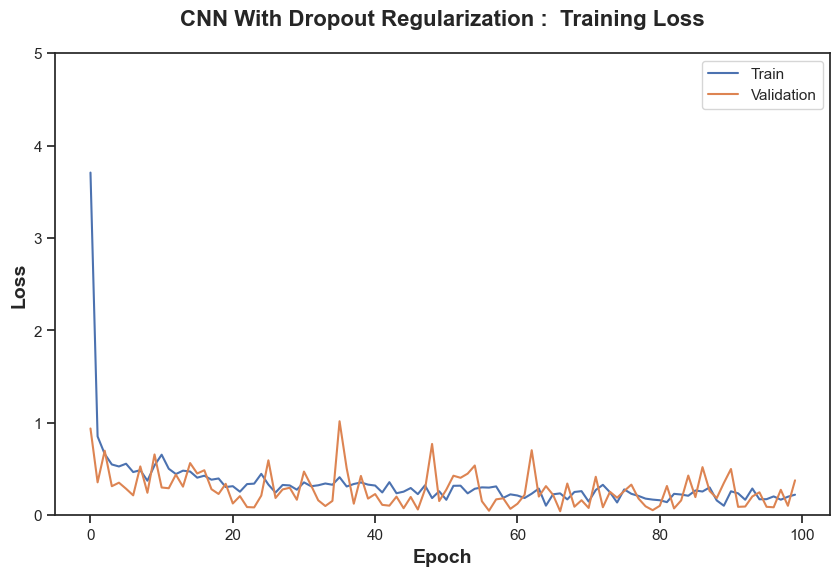

In [80]:
##################################
# Plotting the loss profile
# for CNN with dropout regularization
# on the training and validation sets
##################################
plot_training_history(model_dr_history, 'CNN With Dropout Regularization : ')

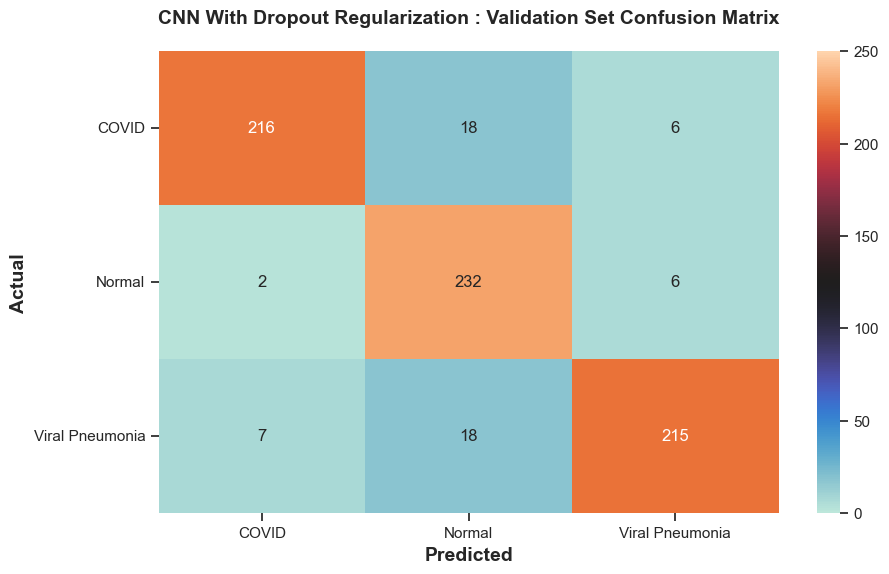

In [81]:
##################################
# Consolidating the predictions
# for CNN with dropout regularization
# on the validation set
##################################
model_dr_predictions = np.array(list(map(lambda x: np.argmax(x), model_dr_y_pred)))
model_dr_y_true=test_gen.classes

##################################
# Formulating the confusion matrix
# for CNN with dropout regularization
# on the validation set
##################################
CMatrix = pd.DataFrame(confusion_matrix(model_dr_y_true, model_dr_predictions), columns=classes, index =classes)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with dropout regularization
# for each category of the validation set
##################################
plt.figure(figsize=(10, 6))
ax = sns.heatmap(CMatrix, annot = True, fmt = 'g' ,vmin = 0, vmax = 250, cmap = 'icefire')
ax.set_xlabel('Predicted',fontsize = 14,weight = 'bold')
ax.set_xticklabels(ax.get_xticklabels(),rotation =0)
ax.set_ylabel('Actual',fontsize = 14,weight = 'bold') 
ax.set_yticklabels(ax.get_yticklabels(),rotation =0)
ax.set_title('CNN With Dropout Regularization : Validation Set Confusion Matrix',fontsize = 14, weight = 'bold', pad=20);

##################################
# Resetting all states generated by Keras
##################################
keras.backend.clear_session()

In [82]:
##################################
# Calculating the model accuracy
# for CNN with dropout regularization
# for the entire validation set
##################################
model_dr_acc = accuracy_score(model_dr_y_true, model_dr_predictions)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with dropout regularization
# for the entire validation set
##################################
model_dr_results_all = precision_recall_fscore_support(model_dr_y_true, model_dr_predictions, average='macro',zero_division = 1)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with dropout regularization
# for each category of the validation set
##################################
model_dr_results_class = precision_recall_fscore_support(model_dr_y_true, model_dr_predictions, average=None, zero_division = 1)

##################################
# Consolidating all model evaluation metrics 
# for CNN with dropout regularization
##################################
metric_columns = ['Precision','Recall', 'F-Score','Support']
model_dr_all_df = pd.concat([pd.DataFrame(list(model_dr_results_class)).T,pd.DataFrame(list(model_dr_results_all)).T])
model_dr_all_df.columns = metric_columns
model_dr_all_df.index = ['COVID', 'Normal', 'Viral Pneumonia','Total']
model_dr_all_df

,Precision,Recall,F-Score,Support
COVID,0.960000,0.900000,0.929032,240.0
Normal,0.865672,0.966667,0.913386,240.0
Viral Pneumonia,0.947137,0.895833,0.920771,240.0
Total,0.924269,0.920833,0.921063,NaN


In [83]:
##################################
# Consolidating all model evaluation metrics 
# for CNN with dropout regularization
##################################
model_dr_model_list = []
model_dr_measure_list = []
model_dr_category_list = []
model_dr_value_list = []

for i in range(3): 
    for j in range(4):
        model_dr_model_list.append('CNN_DR')
        model_dr_measure_list.append(metric_columns[i])
        model_dr_category_list.append(model_dr_all_df.index[j])
        model_dr_value_list.append(model_dr_all_df.iloc[j,i])

model_dr_all_summary = pd.DataFrame(zip(model_dr_model_list,
                                        model_dr_measure_list,
                                        model_dr_category_list,
                                        model_dr_value_list), 
                                        columns=['CNN.Model.Name',
                                                 'Model.Metric',
                                                 'Image.Category',
                                                 'Metric.Value'])

#### 1.3.5.4 CNN With Batch Normalization Regularization <a class="anchor" id="1.3.5.4"></a>

1. The [convolutional neural network model](https://www.tensorflow.org/api_docs/python/tf/keras/models) from the <mark style="background-color: #CCECFF"><b>keras.models</b></mark> Python library API was implemented. 
2. The model contains 9 layers with fixed hyperparameters as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * <span style="color: #FF0000">filters</span> = 32
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
        * <span style="color: #FF0000">input_shape</span> = 299x299x1
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * <span style="color: #FF0000">filters</span> = 64
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
    * <span style="color: #FF0000">BatchNormalization: batch_normalization</span>
    * <span style="color: #FF0000">Activation: activation</span>
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Flatten: flatten</span>
    * <span style="color: #FF0000">Dense: dense</span>
        * <span style="color: #FF0000">units</span> = 128
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
    * <span style="color: #FF0000">Dense: dense_1</span>
        * <span style="color: #FF0000">units</span> = 3
        * <span style="color: #FF0000">activation</span> = softmax
3. Additional fixed hyperparameters used during model compilation are as follows:
    * <span style="color: #FF0000">loss</span> = categorical_crossentropy
    * <span style="color: #FF0000">optimizer</span> = adam (adaptive moment estimation)
    * <span style="color: #FF0000">metrics</span> = recall
4. The model contained 44,878,979 trainable parameters broken down per layer as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * output size = 299x299x32
        * number of parameters = 320
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * output size = 149x149x32
        * number of parameters = 0
    * <span style="color: #FF0000">BatchNormalization: batch_normalization</span>
        * output size = 149x149x64
        * number of parameters = 256
    * <span style="color: #FF0000">Activation: activation</span>
        * output size = 149x149x64
        * number of parameters = 0 
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * output size = 149x149x64
        * number of parameters = 18496 
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * output size = 74x74x64
        * number of parameters = 0
    * <span style="color: #FF0000">Flatten: flatten</span>
        * output size = 350464
        * number of parameters = 0
    * <span style="color: #FF0000">Dense: dense</span>
        * output size = 128
        * number of parameters = 44859520
    * <span style="color: #FF0000">Dense: dense_1</span>
        * output size = 3
        * number of parameters = 387
5. The model performance on the validation set for all image categories is summarized as follows:
    * **Precision** = 0.9107
    * **Recall** = 0.9083
    * **F1 Score** = 0.9081
    

In [84]:
##################################
# Formulating the network architecture
# for CNN with batch normalization regularization
##################################
set_seed()
batch_size = 16
model_bnr = Sequential()
model_bnr.add(Conv2D(filters=32, kernel_size=(3, 3), activation='relu', padding='Same', input_shape=(299, 299, 1), name="conv2d"))
model_bnr.add(MaxPooling2D(pool_size=(2, 2), name="max_pooling2d"))
model_bnr.add(Conv2D(filters=64, kernel_size=(3, 3), padding='Same', activation='relu', name="conv2d_1"))
model_bnr.add(BatchNormalization(name="batch_normalization"))
model_bnr.add(Activation('relu', name="activation"))
model_bnr.add(MaxPooling2D(pool_size=(2, 2), name="max_pooling2d_1"))
model_bnr.add(Flatten(name="flatten"))
model_bnr.add(Dense(units=128, activation='relu', name="dense"))
model_bnr.add(Dense(units=num_classes, activation='softmax', name="dense_1"))

##################################
# Compiling the network layers
##################################
model_bnr.compile(loss='categorical_crossentropy', optimizer='adam', metrics=[Recall()])

In [85]:
##################################
# Displaying the model summary
# for CNN with batch normalization regularization
##################################
print(model_bnr.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 299, 299, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 149, 149, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 149, 149, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 149, 149, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation (Activation)              │ (None, 149, 149, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 74, 74, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 350464)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      44,859,520 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 3)                   │             387 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 44,878,979 (171.20 MB)

 Trainable params: 44,878,851 (171.20 MB)

 Non-trainable params: 128 (512.00 B)

None


In [86]:
##################################
# Displaying the model layers
# for CNN with batch normalization regularization
##################################
model_bnr_layer_names = [layer.name for layer in model_bnr.layers]
print("Layer Names:", model_bnr_layer_names)

Layer Names: ['conv2d', 'max_pooling2d', 'conv2d_1', 'batch_normalization', 'activation', 'max_pooling2d_1', 'flatten', 'dense', 'dense_1']


In [87]:
##################################
# Displaying the number of weights
# for each model layer
# for CNN with batch normalization regularization
##################################
for layer in model_bnr.layers:
    if hasattr(layer, 'weights'):
        print(f"Layer: {layer.name}, Number of Weights: {len(layer.get_weights())}")

Layer: conv2d, Number of Weights: 2
Layer: max_pooling2d, Number of Weights: 0
Layer: conv2d_1, Number of Weights: 2
Layer: batch_normalization, Number of Weights: 4
Layer: activation, Number of Weights: 0
Layer: max_pooling2d_1, Number of Weights: 0
Layer: flatten, Number of Weights: 0
Layer: dense, Number of Weights: 2
Layer: dense_1, Number of Weights: 2


In [88]:
##################################
# Displaying the number of weights
# for each model layer
# for CNN with batch normalization regularization
##################################
total_parameters = 0
for layer in model_bnr.layers:
    layer_parameters = layer.count_params()
    total_parameters += layer_parameters
    print(f"Layer: {layer.name}, Parameters: {layer_parameters}")
print("\nTotal Parameters in the Model:", total_parameters)

Layer: conv2d, Parameters: 320
Layer: max_pooling2d, Parameters: 0
Layer: conv2d_1, Parameters: 18496
Layer: batch_normalization, Parameters: 256
Layer: activation, Parameters: 0
Layer: max_pooling2d_1, Parameters: 0
Layer: flatten, Parameters: 0
Layer: dense, Parameters: 44859520
Layer: dense_1, Parameters: 387

Total Parameters in the Model: 44878979


In [89]:
##################################
# Fitting the model
# for CNN with batch normalization regularization
##################################
epochs = 100
set_seed()
model_bnr_history = model_bnr.fit(train_gen, 
                                  steps_per_epoch=len(train_gen) // batch_size,  
                                  validation_steps=len(test_gen) // batch_size, 
                                  validation_data=test_gen, epochs=epochs,
                                  verbose=0)

In [90]:
##################################
# Evaluating the model
# for CNN with batch normalization regularization
# on the independent validation set
##################################
model_bnr_y_pred = model_bnr.predict(test_gen)

45/45 ━━━━━━━━━━━━━━━━━━━━ 6s 132ms/step


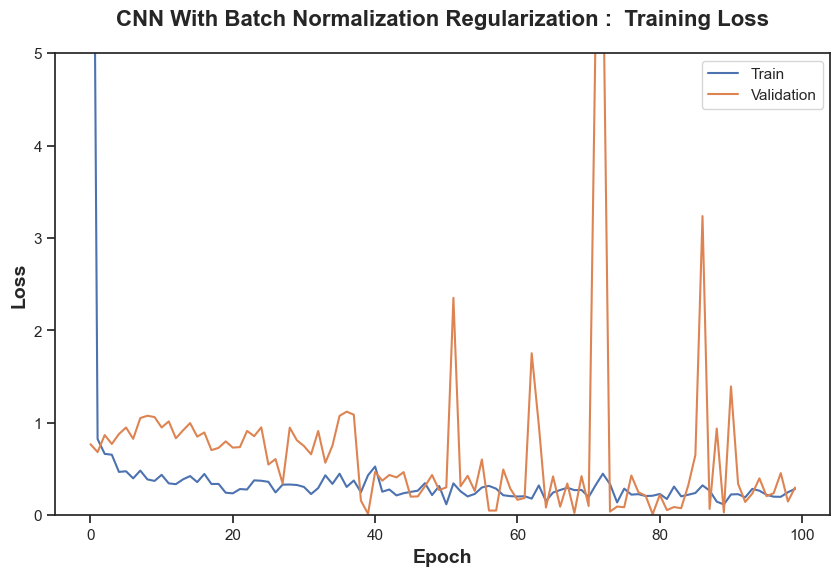

In [91]:
##################################
# Plotting the loss profile
# for CNN with batch normalization regularization
# on the training and validation sets
##################################
plot_training_history(model_bnr_history, 'CNN With Batch Normalization Regularization : ')

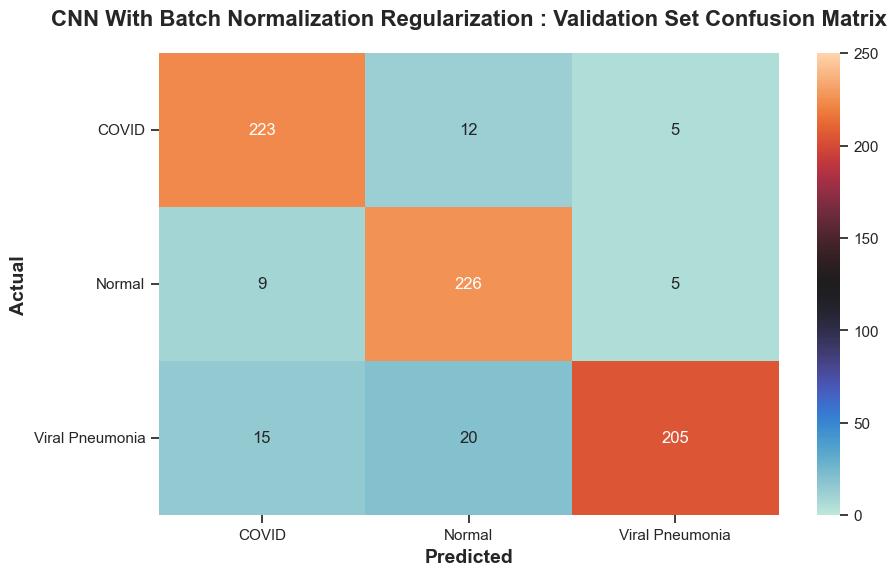

In [92]:
##################################
# Consolidating the predictions
# for CNN with batch normalization regularization
# on the validation set
##################################
model_bnr_predictions = np.array(list(map(lambda x: np.argmax(x), model_bnr_y_pred)))
model_bnr_y_true = test_gen.classes

##################################
# Formulating the confusion matrix
# for CNN with batch normalization regularization
# on the validation set
##################################
CMatrix = pd.DataFrame(confusion_matrix(model_bnr_y_true, model_bnr_predictions), columns=classes, index =classes)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with batch normalization regularization
# for each category of the validation set
##################################
plt.figure(figsize=(10, 6))
ax = sns.heatmap(CMatrix, annot = True, fmt = 'g' ,vmin = 0, vmax = 250,cmap = 'icefire')
ax.set_xlabel('Predicted',fontsize = 14,weight = 'bold')
ax.set_xticklabels(ax.get_xticklabels(),rotation =0)
ax.set_ylabel('Actual',fontsize = 14,weight = 'bold') 
ax.set_yticklabels(ax.get_yticklabels(),rotation =0)
ax.set_title('CNN With Batch Normalization Regularization : Validation Set Confusion Matrix',fontsize = 16,weight = 'bold',pad=20);

##################################
# Resetting all states generated by Keras
##################################
keras.backend.clear_session()

In [93]:
##################################
# Calculating the model accuracy
# for CNN with batch normalization regularization
# for the entire validation set
##################################
model_bnr_acc = accuracy_score(model_bnr_y_true, model_bnr_predictions)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with batch normalization regularization
# for the entire validation set
##################################
model_bnr_results_all = precision_recall_fscore_support(model_bnr_y_true, model_bnr_predictions, average='macro',zero_division = 1)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with batch normalization regularization
# for each category of the validation set
##################################
model_bnr_results_class = precision_recall_fscore_support(model_bnr_y_true, model_bnr_predictions, average=None, zero_division = 1)

##################################
# Consolidating all model evaluation metrics 
# for CNN with batch normalization regularization
##################################
metric_columns = ['Precision','Recall', 'F-Score','Support']
model_bnr_all_df = pd.concat([pd.DataFrame(list(model_bnr_results_class)).T,pd.DataFrame(list(model_bnr_results_all)).T])
model_bnr_all_df.columns = metric_columns
model_bnr_all_df.index = ['COVID', 'Normal', 'Viral Pneumonia','Total']
model_bnr_all_df

,Precision,Recall,F-Score,Support
COVID,0.902834,0.929167,0.915811,240.0
Normal,0.875969,0.941667,0.907631,240.0
Viral Pneumonia,0.953488,0.854167,0.901099,240.0
Total,0.910764,0.908333,0.908180,NaN


In [94]:
##################################
# Consolidating all model evaluation metrics 
# for CNN with batch normalization regularization
##################################
model_bnr_model_list = []
model_bnr_measure_list = []
model_bnr_category_list = []
model_bnr_value_list = []

for i in range(3): 
    for j in range(4):
        model_bnr_model_list.append('CNN_BNR')
        model_bnr_measure_list.append(metric_columns[i])
        model_bnr_category_list.append(model_bnr_all_df.index[j])
        model_bnr_value_list.append(model_bnr_all_df.iloc[j,i])

model_bnr_all_summary = pd.DataFrame(zip(model_bnr_model_list,
                                        model_bnr_measure_list,
                                        model_bnr_category_list,
                                        model_bnr_value_list), 
                                        columns=['CNN.Model.Name',
                                                 'Model.Metric',
                                                 'Image.Category',
                                                 'Metric.Value'])

#### 1.3.5.5 CNN With Dropout and Batch Normalization Regularization <a class="anchor" id="1.3.5.5"></a>

1. The [convolutional neural network model](https://www.tensorflow.org/api_docs/python/tf/keras/models) from the <mark style="background-color: #CCECFF"><b>keras.models</b></mark> Python library API was implemented. 
2. The model contains 10 layers with fixed hyperparameters as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * <span style="color: #FF0000">filters</span> = 32
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
        * <span style="color: #FF0000">input_shape</span> = 299x299x1
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * <span style="color: #FF0000">filters</span> = 64
        * <span style="color: #FF0000">kernel_size</span> = 3x3
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
        * <span style="color: #FF0000">padding</span> = same (output size equals input size)
    * <span style="color: #FF0000">BatchNormalization: batch_normalization</span>
    * <span style="color: #FF0000">Activation: activation</span>
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
    * <span style="color: #FF0000">Dropout: dropout</span>
        * <span style="color: #FF0000">rate</span> = 0.25
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * <span style="color: #FF0000">pool_size</span> = 2x2
    * <span style="color: #FF0000">Flatten: flatten</span>
    * <span style="color: #FF0000">Dense: dense</span>
        * <span style="color: #FF0000">units</span> = 128
        * <span style="color: #FF0000">activation</span> = relu (rectified linear unit)
    * <span style="color: #FF0000">Dense: dense_1</span>
        * <span style="color: #FF0000">units</span> = 3
        * <span style="color: #FF0000">activation</span> = softmax
3. Additional fixed hyperparameters used during model compilation are as follows:
    * <span style="color: #FF0000">loss</span> = categorical_crossentropy
    * <span style="color: #FF0000">optimizer</span> = adam (adaptive moment estimation)
    * <span style="color: #FF0000">metrics</span> = recall
4. The model contained 44,878,979 trainable parameters broken down per layer as follows:
    * <span style="color: #FF0000">Conv2D: conv2d</span>
        * output size = 299x299x32
        * number of parameters = 320
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d</span>
        * output size = 149x149x32
        * number of parameters = 0
    * <span style="color: #FF0000">BatchNormalization: batch_normalization</span>
        * output size = 149x149x64
        * number of parameters = 256
    * <span style="color: #FF0000">Activation: activation</span>
        * output size = 149x149x64
        * number of parameters = 0 
    * <span style="color: #FF0000">Dropout: dropout</span>
        * output size = 149x149x64
        * number of parameters = 0 
    * <span style="color: #FF0000">Conv2D: conv2d_1</span>
        * output size = 149x149x64
        * number of parameters = 18496 
    * <span style="color: #FF0000">MaxPooling2D: max_pooling2d_1</span>
        * output size = 74x74x64
        * number of parameters = 0
    * <span style="color: #FF0000">Flatten: flatten</span>
        * output size = 350464
        * number of parameters = 0
    * <span style="color: #FF0000">Dense: dense</span>
        * output size = 128
        * number of parameters = 44859520
    * <span style="color: #FF0000">Dense: dense_1</span>
        * output size = 3
        * number of parameters = 387
5. The model performance on the validation set for all classes is summarized as follows:
    * **Precision** = 0.9182
    * **Recall** = 0.9166
    * **F1 Score** = 0.9167

In [95]:
##################################
# Formulating the network architecture
# for CNN with dropout and batch normalization regularization
##################################
set_seed()
batch_size = 16
model_dr_bnr = Sequential()
model_dr_bnr.add(Conv2D(filters=32, kernel_size=(3, 3), activation='relu', padding='Same', input_shape=(299, 299, 1)))
model_dr_bnr.add(MaxPooling2D(pool_size=(2, 2)))
model_dr_bnr.add(Conv2D(filters=64, kernel_size=(3, 3), padding='Same', activation='relu'))
model_dr_bnr.add(BatchNormalization())
model_dr_bnr.add(Activation('relu'))
model_dr_bnr.add(Dropout(0.25))
model_dr_bnr.add(MaxPooling2D(pool_size=(2, 2)))
model_dr_bnr.add(Flatten())
model_dr_bnr.add(Dense(units=128, activation='relu'))
model_dr_bnr.add(Dense(units=num_classes, activation='softmax'))

##################################
# Compiling the network layers
##################################
model_dr_bnr.compile(loss='categorical_crossentropy', optimizer='adam', metrics=[Recall()])

In [96]:
##################################
# Displaying the model summary
# for CNN with dropout and
# batch normalization regularization
##################################
print(model_dr_bnr.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 299, 299, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 149, 149, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 149, 149, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 149, 149, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation (Activation)              │ (None, 149, 149, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 149, 149, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 74, 74, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 350464)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      44,859,520 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 3)                   │             387 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 44,878,979 (171.20 MB)

 Trainable params: 44,878,851 (171.20 MB)

 Non-trainable params: 128 (512.00 B)

None


In [97]:
##################################
# Displaying the model layers
# for CNN with dropout and
# batch normalization regularization
##################################
model_dr_bnr_layer_names = [layer.name for layer in model_dr_bnr.layers]
print("Layer Names:", model_dr_bnr_layer_names)

Layer Names: ['conv2d', 'max_pooling2d', 'conv2d_1', 'batch_normalization', 'activation', 'dropout', 'max_pooling2d_1', 'flatten', 'dense', 'dense_1']


In [98]:
##################################
# Displaying the number of weights
# for CNN with dropout and
# batch normalization regularization
##################################
for layer in model_dr_bnr.layers:
    if hasattr(layer, 'weights'):
        print(f"Layer: {layer.name}, Number of Weights: {len(layer.get_weights())}")

Layer: conv2d, Number of Weights: 2
Layer: max_pooling2d, Number of Weights: 0
Layer: conv2d_1, Number of Weights: 2
Layer: batch_normalization, Number of Weights: 4
Layer: activation, Number of Weights: 0
Layer: dropout, Number of Weights: 0
Layer: max_pooling2d_1, Number of Weights: 0
Layer: flatten, Number of Weights: 0
Layer: dense, Number of Weights: 2
Layer: dense_1, Number of Weights: 2


In [99]:
##################################
# Displaying the number of weights
# for CNN with dropout and
# batch normalization regularization
##################################
total_parameters = 0
for layer in model_dr_bnr.layers:
    layer_parameters = layer.count_params()
    total_parameters += layer_parameters
    print(f"Layer: {layer.name}, Parameters: {layer_parameters}")
print("\nTotal Parameters in the Model:", total_parameters)

Layer: conv2d, Parameters: 320
Layer: max_pooling2d, Parameters: 0
Layer: conv2d_1, Parameters: 18496
Layer: batch_normalization, Parameters: 256
Layer: activation, Parameters: 0
Layer: dropout, Parameters: 0
Layer: max_pooling2d_1, Parameters: 0
Layer: flatten, Parameters: 0
Layer: dense, Parameters: 44859520
Layer: dense_1, Parameters: 387

Total Parameters in the Model: 44878979


In [100]:
##################################
# Fitting the model
# for CNN with dropout and
# batch normalization regularization
##################################
epochs = 100
set_seed()
model_dr_bnr_history = model_dr_bnr.fit(train_gen,
                                        steps_per_epoch=len(train_gen) // batch_size,   
                                        validation_steps=len(test_gen) // batch_size, 
                                        validation_data=test_gen, 
                                        epochs=epochs,
                                        verbose=0)

In [101]:
##################################
# Evaluating the model
# for CNN with dropout and
# batch normalization regularization
# on the independent validation set
##################################
model_dr_bnr_y_pred = model_dr_bnr.predict(test_gen)

45/45 ━━━━━━━━━━━━━━━━━━━━ 6s 136ms/step


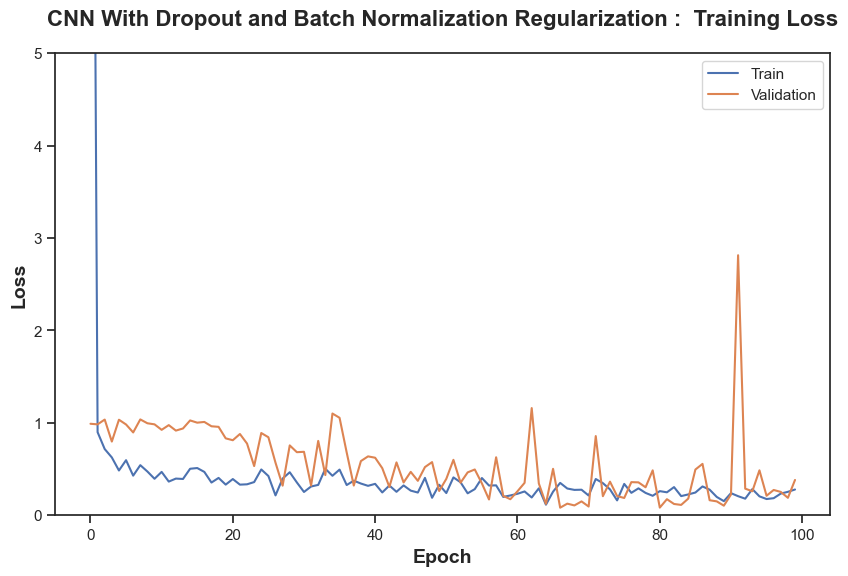

In [102]:
##################################
# Plotting the loss profile
# for CNN with dropout and
# batch normalization regularization
# on the training and validation sets
##################################
plot_training_history(model_dr_bnr_history, 'CNN With Dropout and Batch Normalization Regularization : ')

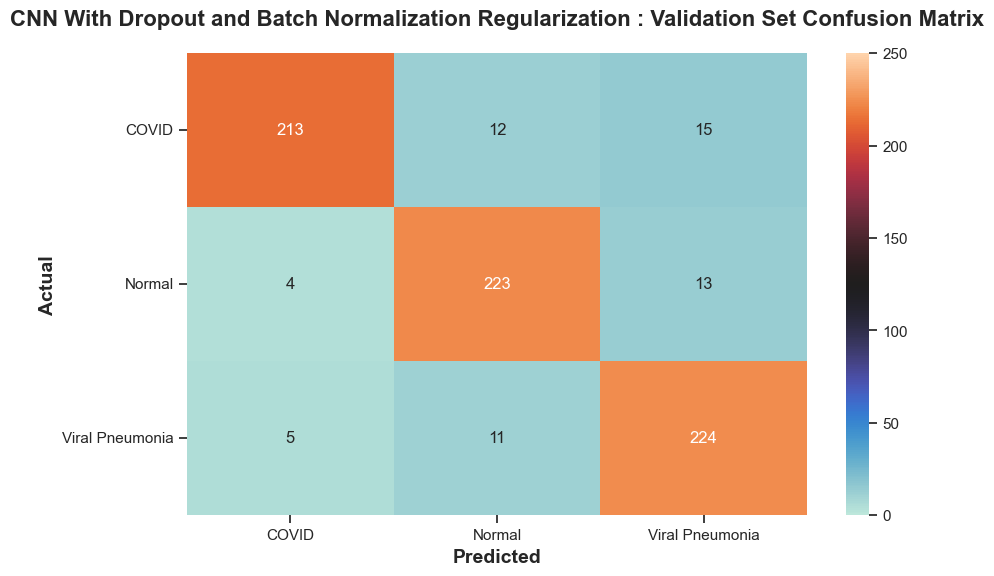

In [103]:
##################################
# Consolidating the predictions
# for CNN with dropout and
# batch normalization regularization
# on the validation set
##################################
model_dr_bnr_predictions = np.array(list(map(lambda x: np.argmax(x), model_dr_bnr_y_pred)))
model_dr_bnr_y_true = test_gen.classes

##################################
# Formulating the confusion matrix
# for CNN with dropout and
# batch normalization regularization
# on the validation set
##################################
CMatrix = pd.DataFrame(confusion_matrix(model_dr_bnr_y_true, model_dr_bnr_predictions), columns=classes, index =classes)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with dropout and
# batch normalization regularization
# for each category of the validation set
##################################
plt.figure(figsize=(10, 6))
ax = sns.heatmap(CMatrix, annot = True, fmt = 'g' ,vmin = 0, vmax = 250,cmap = 'icefire')
ax.set_xlabel('Predicted',fontsize = 14,weight = 'bold')
ax.set_xticklabels(ax.get_xticklabels(),rotation =0)
ax.set_ylabel('Actual',fontsize = 14,weight = 'bold') 
ax.set_yticklabels(ax.get_yticklabels(),rotation =0)
ax.set_title('CNN With Dropout and Batch Normalization Regularization : Validation Set Confusion Matrix',fontsize = 16,weight = 'bold',pad=20);

##################################
# Resetting all states generated by Keras
##################################
keras.backend.clear_session()

In [104]:
##################################
# Calculating the model accuracy
# for CNN with dropout and
# batch normalization regularization
# for the entire validation set
##################################
model_dr_bnr_acc = accuracy_score(model_dr_bnr_y_true, model_dr_bnr_predictions)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with dropout and
# batch normalization regularization
# for the entire validation set
##################################
model_dr_bnr_results_all = precision_recall_fscore_support(model_dr_bnr_y_true, model_dr_bnr_predictions, average='macro',zero_division = 1)

##################################
# Calculating the model 
# Precision, Recall, F-score and Support
# for CNN with dropout and
# batch normalization regularization
# for each category of the validation set
##################################
model_dr_bnr_results_class = precision_recall_fscore_support(model_dr_bnr_y_true, model_dr_bnr_predictions, average=None, zero_division = 1)

##################################
# Consolidating all model evaluation metrics 
# for CNN with dropout and
# batch normalization regularization
##################################
metric_columns = ['Precision','Recall', 'F-Score','Support']
model_dr_bnr_all_df = pd.concat([pd.DataFrame(list(model_dr_bnr_results_class)).T,pd.DataFrame(list(model_dr_bnr_results_all)).T])
model_dr_bnr_all_df.columns = metric_columns
model_dr_bnr_all_df.index = ['COVID', 'Normal', 'Viral Pneumonia','Total']
model_dr_bnr_all_df

,Precision,Recall,F-Score,Support
COVID,0.959459,0.887500,0.922078,240.0
Normal,0.906504,0.929167,0.917695,240.0
Viral Pneumonia,0.888889,0.933333,0.910569,240.0
Total,0.918284,0.916667,0.916781,NaN


In [105]:
##################################
# Consolidating all model evaluation metrics 
# for CNN with dropout and
# batch normalization regularization
##################################
model_dr_bnr_model_list = []
model_dr_bnr_measure_list = []
model_dr_bnr_category_list = []
model_dr_bnr_value_list = []

for i in range(3): 
    for j in range(4):
        model_dr_bnr_model_list.append('CNN_DR_BNR')
        model_dr_bnr_measure_list.append(metric_columns[i])
        model_dr_bnr_category_list.append(model_dr_bnr_all_df.index[j])
        model_dr_bnr_value_list.append(model_dr_bnr_all_df.iloc[j,i])

model_dr_bnr_all_summary = pd.DataFrame(zip(model_dr_bnr_model_list,
                                            model_dr_bnr_measure_list,
                                            model_dr_bnr_category_list,
                                            model_dr_bnr_value_list), 
                                        columns=['CNN.Model.Name',
                                                 'Model.Metric',
                                                 'Image.Category',
                                                 'Metric.Value'])


### 1.3.6 Model Selection <a class="anchor" id="1.3.6"></a>

1. The **CNN Model With No Regularization** demonstrated the following validation set performance for all image categories:
    * **Precision** = 0.9202
    * **Recall** = 0.9125
    * **F1 Score** = 0.9129    
2. The **CNN Model With Dropout Regularization** demonstrated the following validation set performance for all image categories:
    * **Precision** = 0.9242
    * **Recall** = 0.9208
    * **F1 Score** = 0.9210
3. The **CNN Model With Batch Normalization Regularization** demonstrated the following validation set performance for all image categories:
    * **Precision** = 0.9107
    * **Recall** = 0.9083
    * **F1 Score** = 0.9081
4. The **CNN Model With Dropout and Batch Normalization Regularization** demonstrated the following validation set performance for all image categories:
    * **Precision** = 0.9182
    * **Recall** = 0.9166
    * **F1 Score** = 0.9167
5. The **CNN Model With Dropout Regularization** had the best validation set performance and was selected among all candidate models.
    * **Precision** = 0.9242
    * **Recall** = 0.9208
    * **F1 Score** = 0.9210
6. While the classification results have been sufficiently high, the current study can be further extended to achieve optimal model performance through the following:
    * Conduct model hyperparameter tuning given sufficient analysis time and higher computing power
    * Formulate deeper neural network architectures to better capture spatial hierarchies and features in the input images
    * Apply various techniques to interpret the CNN models by understanding and visualizing the features and decisions made at each layer 
    * Consider an imbalanced dataset and apply remedial measures to address unbalanced classification to accurately reflect real-world scenario
    

In [106]:
##################################
# Consolidating all the
# CNN model performance measures
##################################
cnn_model_performance_comparison = pd.concat([model_nr_all_summary, 
                                              model_dr_all_summary,
                                              model_bnr_all_summary, 
                                              model_dr_bnr_all_summary], 
                                             ignore_index=True)

In [107]:
##################################
# Consolidating all the precision
# model performance measures
##################################
cnn_model_performance_comparison_precision = cnn_model_performance_comparison[cnn_model_performance_comparison['Model.Metric']=='Precision']
cnn_model_performance_comparison_precision_CNN_NR = cnn_model_performance_comparison_precision[cnn_model_performance_comparison_precision['CNN.Model.Name']=='CNN_NR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_precision_CNN_DR = cnn_model_performance_comparison_precision[cnn_model_performance_comparison_precision['CNN.Model.Name']=='CNN_DR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_precision_CNN_BNR = cnn_model_performance_comparison_precision[cnn_model_performance_comparison_precision['CNN.Model.Name']=='CNN_BNR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_precision_CNN_DR_BNR = cnn_model_performance_comparison_precision[cnn_model_performance_comparison_precision['CNN.Model.Name']=='CNN_DR_BNR'].loc[:,"Metric.Value"]

In [108]:
##################################
# Combining all the precision
# model performance measures
# for all CNN models
##################################
cnn_model_performance_comparison_precision_plot = pd.DataFrame({'CNN_NR': cnn_model_performance_comparison_precision_CNN_NR.values,
                                                                'CNN_DR': cnn_model_performance_comparison_precision_CNN_DR.values,
                                                                'CNN_BNR': cnn_model_performance_comparison_precision_CNN_BNR.values,
                                                                'CNN_DR_BNR': cnn_model_performance_comparison_precision_CNN_DR_BNR.values},
                                                               index=cnn_model_performance_comparison_precision['Image.Category'].unique())
cnn_model_performance_comparison_precision_plot

,CNN_NR,CNN_DR,CNN_BNR,CNN_DR_BNR
COVID,0.959459,0.960000,0.902834,0.959459
Normal,0.833922,0.865672,0.875969,0.906504
Viral Pneumonia,0.967442,0.947137,0.953488,0.888889
Total,0.920275,0.924269,0.910764,0.918284


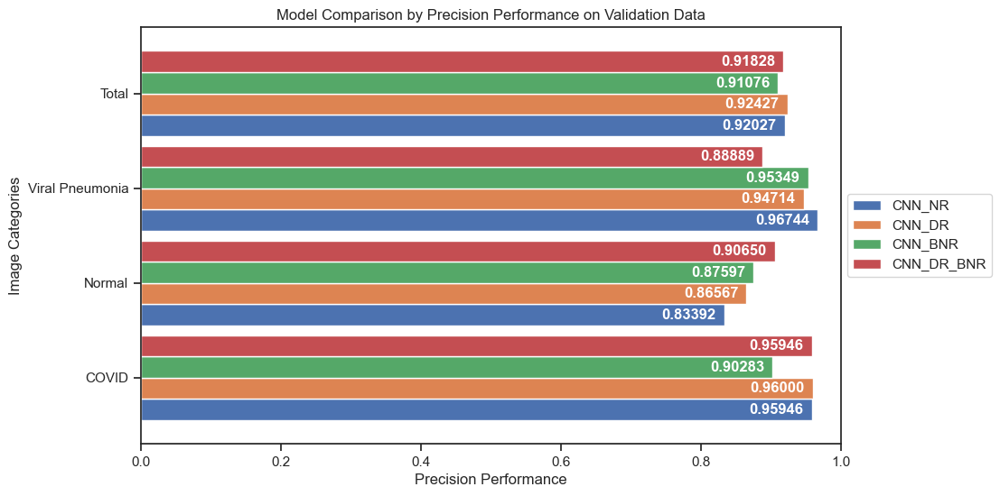

In [109]:
##################################
# Plotting all the precision
# model performance measures
# for all CNN models
##################################
cnn_model_performance_comparison_precision_plot = cnn_model_performance_comparison_precision_plot.plot.barh(figsize=(10, 6), width=0.90)
cnn_model_performance_comparison_precision_plot.set_xlim(0.00,1.00)
cnn_model_performance_comparison_precision_plot.set_title("Model Comparison by Precision Performance on Validation Data")
cnn_model_performance_comparison_precision_plot.set_xlabel("Precision Performance")
cnn_model_performance_comparison_precision_plot.set_ylabel("Image Categories")
cnn_model_performance_comparison_precision_plot.grid(False)
cnn_model_performance_comparison_precision_plot.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
for container in cnn_model_performance_comparison_precision_plot.containers:
    cnn_model_performance_comparison_precision_plot.bar_label(container, fmt='%.5f', padding=-50, color='white', fontweight='bold')

In [110]:
##################################
# Consolidating all the recall
# model performance measures
##################################
cnn_model_performance_comparison_recall = cnn_model_performance_comparison[cnn_model_performance_comparison['Model.Metric']=='Recall']
cnn_model_performance_comparison_recall_CNN_NR = cnn_model_performance_comparison_recall[cnn_model_performance_comparison_recall['CNN.Model.Name']=='CNN_NR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_recall_CNN_DR = cnn_model_performance_comparison_recall[cnn_model_performance_comparison_recall['CNN.Model.Name']=='CNN_DR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_recall_CNN_BNR = cnn_model_performance_comparison_recall[cnn_model_performance_comparison_recall['CNN.Model.Name']=='CNN_BNR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_recall_CNN_DR_BNR = cnn_model_performance_comparison_recall[cnn_model_performance_comparison_recall['CNN.Model.Name']=='CNN_DR_BNR'].loc[:,"Metric.Value"]

In [111]:
##################################
# Combining all the recall
# model performance measures
# for all CNN models
##################################
cnn_model_performance_comparison_recall_plot = pd.DataFrame({'CNN_NR': cnn_model_performance_comparison_recall_CNN_NR.values,
                                                             'CNN_DR': cnn_model_performance_comparison_recall_CNN_DR.values,
                                                             'CNN_BNR': cnn_model_performance_comparison_recall_CNN_BNR.values,
                                                             'CNN_DR_BNR': cnn_model_performance_comparison_recall_CNN_DR_BNR.values},
                                                            index=cnn_model_performance_comparison_recall['Image.Category'].unique())
cnn_model_performance_comparison_recall_plot

,CNN_NR,CNN_DR,CNN_BNR,CNN_DR_BNR
COVID,0.887500,0.900000,0.929167,0.887500
Normal,0.983333,0.966667,0.941667,0.929167
Viral Pneumonia,0.866667,0.895833,0.854167,0.933333
Total,0.912500,0.920833,0.908333,0.916667


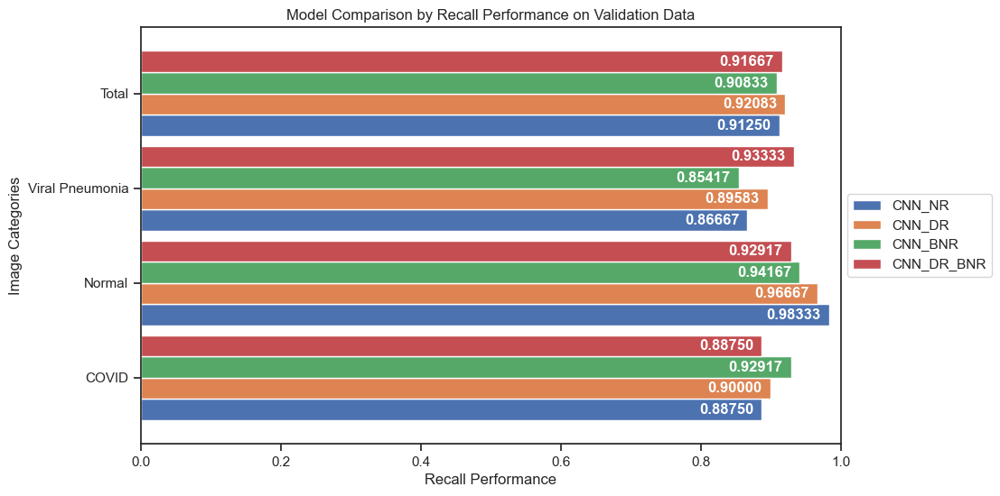

In [112]:
##################################
# Plotting all the recall
# model performance measures
# for all CNN models
##################################
cnn_model_performance_comparison_recall_plot = cnn_model_performance_comparison_recall_plot.plot.barh(figsize=(10, 6), width=0.90)
cnn_model_performance_comparison_recall_plot.set_xlim(0.00,1.00)
cnn_model_performance_comparison_recall_plot.set_title("Model Comparison by Recall Performance on Validation Data")
cnn_model_performance_comparison_recall_plot.set_xlabel("Recall Performance")
cnn_model_performance_comparison_recall_plot.set_ylabel("Image Categories")
cnn_model_performance_comparison_recall_plot.grid(False)
cnn_model_performance_comparison_recall_plot.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
for container in cnn_model_performance_comparison_recall_plot.containers:
    cnn_model_performance_comparison_recall_plot.bar_label(container, fmt='%.5f', padding=-50, color='white', fontweight='bold')

In [113]:
##################################
# Consolidating all the f-score
# model performance measures
##################################
cnn_model_performance_comparison_fscore = cnn_model_performance_comparison[cnn_model_performance_comparison['Model.Metric']=='F-Score']
cnn_model_performance_comparison_fscore_CNN_NR = cnn_model_performance_comparison_fscore[cnn_model_performance_comparison_fscore['CNN.Model.Name']=='CNN_NR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_fscore_CNN_DR = cnn_model_performance_comparison_fscore[cnn_model_performance_comparison_fscore['CNN.Model.Name']=='CNN_DR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_fscore_CNN_BNR = cnn_model_performance_comparison_fscore[cnn_model_performance_comparison_fscore['CNN.Model.Name']=='CNN_BNR'].loc[:,"Metric.Value"]
cnn_model_performance_comparison_fscore_CNN_DR_BNR = cnn_model_performance_comparison_fscore[cnn_model_performance_comparison_fscore['CNN.Model.Name']=='CNN_DR_BNR'].loc[:,"Metric.Value"]

In [114]:
##################################
# Combining all the f-score
# model performance measures
# for all CNN models
##################################
cnn_model_performance_comparison_fscore_plot = pd.DataFrame({'CNN_NR': cnn_model_performance_comparison_fscore_CNN_NR.values,
                                                             'CNN_DR': cnn_model_performance_comparison_fscore_CNN_DR.values,
                                                             'CNN_BNR': cnn_model_performance_comparison_fscore_CNN_BNR.values,
                                                             'CNN_DR_BNR': cnn_model_performance_comparison_fscore_CNN_DR_BNR.values},
                                                            index=cnn_model_performance_comparison_fscore['Image.Category'].unique())
cnn_model_performance_comparison_fscore_plot

,CNN_NR,CNN_DR,CNN_BNR,CNN_DR_BNR
COVID,0.922078,0.929032,0.915811,0.922078
Normal,0.902486,0.913386,0.907631,0.917695
Viral Pneumonia,0.914286,0.920771,0.901099,0.910569
Total,0.912950,0.921063,0.908180,0.916781


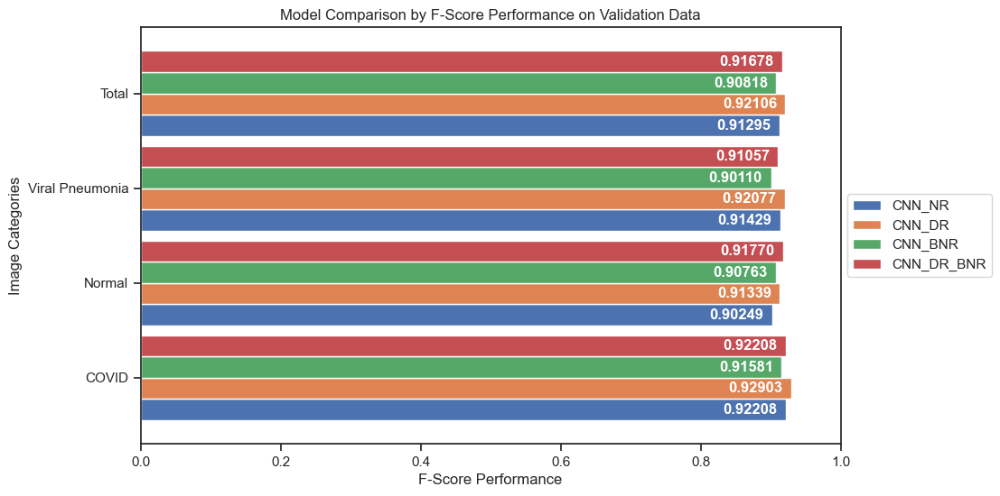

In [115]:
##################################
# Plotting all the fscore
# model performance measures
# for all CNN models
##################################
cnn_model_performance_comparison_fscore_plot = cnn_model_performance_comparison_fscore_plot.plot.barh(figsize=(10, 6), width=0.90)
cnn_model_performance_comparison_fscore_plot.set_xlim(0.00,1.00)
cnn_model_performance_comparison_fscore_plot.set_title("Model Comparison by F-Score Performance on Validation Data")
cnn_model_performance_comparison_fscore_plot.set_xlabel("F-Score Performance")
cnn_model_performance_comparison_fscore_plot.set_ylabel("Image Categories")
cnn_model_performance_comparison_fscore_plot.grid(False)
cnn_model_performance_comparison_fscore_plot.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
for container in cnn_model_performance_comparison_fscore_plot.containers:
    cnn_model_performance_comparison_fscore_plot.bar_label(container, fmt='%.5f', padding=-50, color='white', fontweight='bold')

### 1.3.7 Model Presentation <a class="anchor" id="1.3.7"></a>

#### 1.3.7.1 Convolutional Layer Filter Visualization <a class="anchor" id="1.3.7.1"></a>

1. The visualized filters using the first convolutional layer of the selection model - **CNN Model With Dropout Regularization** showed low-level features including edges and textures.
2. The visualized filters using the second and final convolutional layer of the selected model - **CNN Model With Dropout Regularization** showed mid-level to high-level features including patterns and shapes.

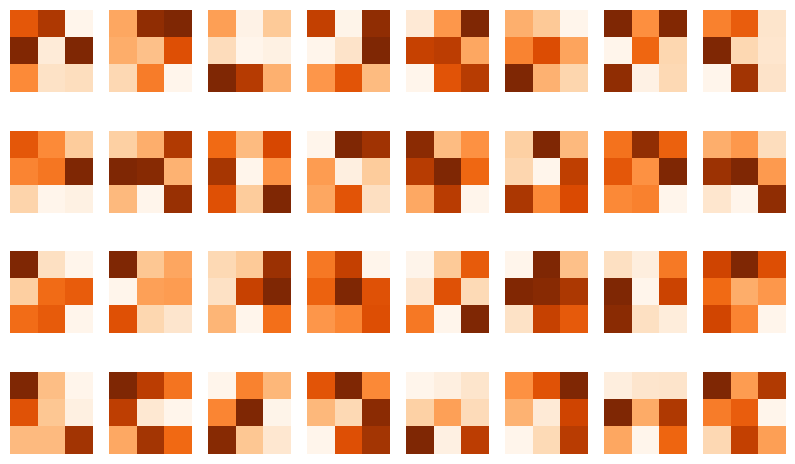

In [116]:
##################################
# Visualizing the learned and updated filters
# for the first convolutional layer
# from the selected CNN model defined as
# CNN with dropout regularization
##################################
conv2d_0_filters, conv2d_0_biases = model_dr.layers[0].get_weights()
plt.figure(figsize=(10, 6))
for i in range(conv2d_0_filters.shape[3]):
    plt.subplot(4, 8, i+1)
    plt.imshow(conv2d_0_filters[:, :, 0, i], cmap='Oranges')
    plt.axis('off')
plt.show()

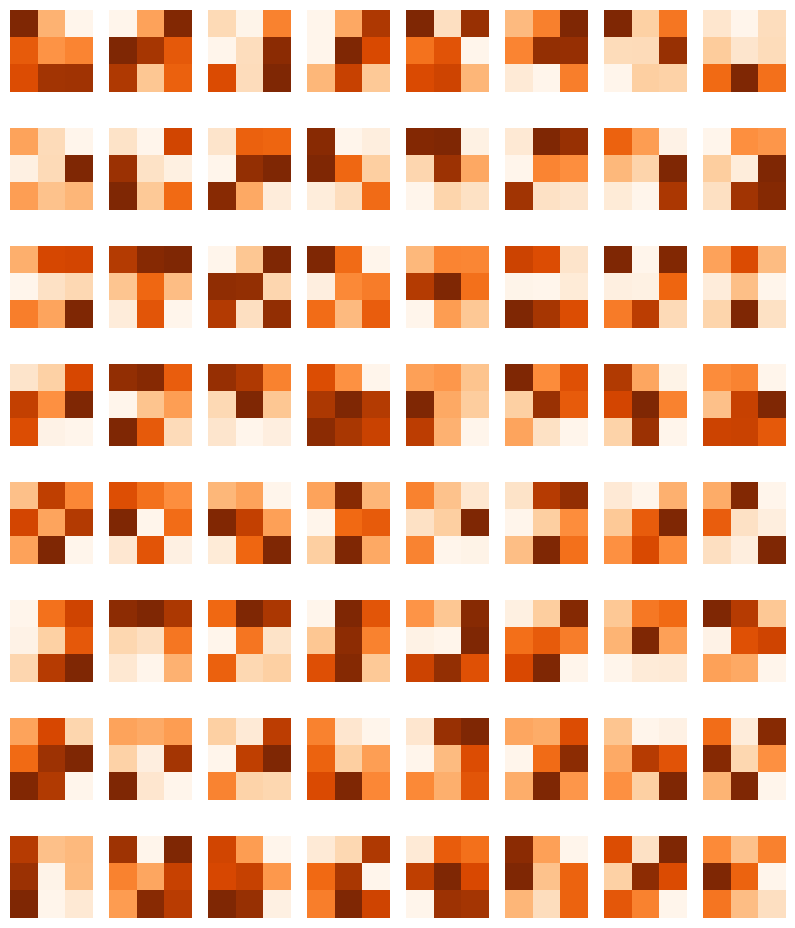

In [117]:
##################################
# Visualizing the learned and updated filters
# for the second convolutional layer
# from the selected CNN model defined as
# CNN with dropout regularization
##################################
conv2d_1_filters, conv2d_1_biases = model_dr.layers[2].get_weights()
plt.figure(figsize=(10, 12))
for i in range(conv2d_1_filters.shape[3]):
    plt.subplot(8, 8, i+1)
    plt.imshow(conv2d_1_filters[:, :, 0, i], cmap='Oranges')
    plt.axis('off')
plt.show()

#### 1.3.7.2 Gradient-Weighted Class Activation Mapping <a class="anchor" id="1.3.7.2"></a>

1. The gradient-weighted class activation map for  the first convolutional layer of the selected model - **CNN Model With Dropout Regularization** highlighted general image features that lead to the activation of the different image categories.
    * 1.1 Images identified with <span style="color: #FF0000">CLASS: COVID</span> had the following characteristics:
        * 1.1.1 Denser intensity for the part of the image pertaining to the lung
        * 1.1.2 Relatively invisible outlines for the part of the image pertaining to the bronchial structure
    * 1.2 Images identified with <span style="color: #FF0000">CLASS: Normal</span> had the following characteristics:
        * 1.2.1 Denser intensity for the part of the image pertaining to the lung
        * 1.2.2 Clearly visible outlines for the part of the image pertaining to the bronchial structure
    * 1.3 Images identified with <span style="color: #FF0000">CLASS: Viral Pneumonia</span> had the following characteristics:
        * 1.3.1 Hazy intensity for the part of the image pertaining to the lung
        * 1.3.2 Relatively visible outlines for the part of the image pertaining to the bronchial structure
2. The gradient-weighted class activation map for  the second and final convolutional layer of the selected model - **CNN Model With Dropout Regularization** highlighted specific image features that lead to the activation of the different image categories.
    * 1.1 Images identified with <span style="color: #FF0000">CLASS: COVID</span> had the following characteristics:
        * 1.1.1 Lung fields appeared patchy and multifocal
        * 1.1.2 Pulmonary vessels and bronchial structures are not clearly visible without signs of obstruction or infiltration
    * 1.2 Images identified with <span style="color: #FF0000">CLASS: Normal</span> had the following characteristics:
        * 1.2.1 Clear lung fields without significant opacities or consolidations
        * 1.2.2 Pulmonary vessels and bronchial structures are clearly visible without signs of obstruction or infiltration
    * 1.3 Images identified with <span style="color: #FF0000">CLASS: Viral Pneumonia</span> had the following characteristics:
        * 1.3.1 Lung fields appeared patchy and multifocal
        * 1.3.2 Pulmonary vessels and bronchial structures are clearly visible but with signs of obstruction or infiltration


In [118]:
##################################
# Gathering the actual and predicted classes
# from the selected CNN model defined as
# CNN with dropout regularization
##################################
model_dr_predictions = np.array(list(map(lambda x: np.argmax(x), model_dr_y_pred)))
model_dr_y_true = test_gen.classes

In [119]:
##################################
# Consolidating the actual and predicted classes
# from the selected CNN model defined as
# CNN with dropout regularization
##################################
class_indices = test_gen.class_indices
indices = {v:k for k,v in class_indices.items()}
filenames = test_gen.filenames
test_gen_df = pd.DataFrame()
test_gen_df['FileName'] = filenames
test_gen_df['Actual_Category'] = model_dr_y_true
test_gen_df['Predicted_Category'] = model_dr_predictions
test_gen_df['Actual_Category'] = test_gen_df['Actual_Category'].apply(lambda x: indices[x])
test_gen_df['Predicted_Category'] = test_gen_df['Predicted_Category'].apply(lambda x: indices[x])
test_gen_df.loc[test_gen_df['Actual_Category']==test_gen_df['Predicted_Category'],'Matched_Category_Prediction'] = True
test_gen_df.loc[test_gen_df['Actual_Category']!=test_gen_df['Predicted_Category'],'Matched_Category_Prediction'] = False
test_gen_df.head(10)

,FileName,Actual_Category,Predicted_Category,Matched_Category_Prediction
0,COVID\COVID-1.png,COVID,COVID,True
1,COVID\COVID-10.png,COVID,COVID,True
2,COVID\COVID-100.png,COVID,COVID,True
3,COVID\COVID-1000.png,COVID,COVID,True
4,COVID\COVID-1001.png,COVID,COVID,True
5,COVID\COVID-1002.png,COVID,COVID,True
6,COVID\COVID-1003.png,COVID,COVID,True
7,COVID\COVID-1004.png,COVID,COVID,True
8,COVID\COVID-1005.png,COVID,COVID,True
9,COVID\COVID-1006.png,COVID,COVID,True


In [120]:
##################################
# Formulating image samples
# from the validation set
##################################
test_gen_df = test_gen_df.sample(frac=1, replace=False, random_state=123).reset_index(drop=True)

In [121]:
##################################
# Defining a function
# to load the sampled images
##################################
img_size=299
def readImage(path):
    img = load_img(path,color_mode="grayscale", target_size=(img_size,img_size))
    img = img_to_array(img)
    img = img/255.    
    return img

In [122]:
##################################
# Defining a function
# to display the sampled images
# with the actual and predicted categories
##################################
base_path = (os.path.join("..", DATASETS_ORIGINAL_PATH))
def display_images(temp_df):
    temp_df = temp_df.reset_index(drop=True)
    plt.figure(figsize = (20 , 20))
    n = 0
    for i in range(15):
        n+=1
        plt.subplot(5 , 5, n)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
        image = readImage(f"{base_path}\\{temp_df.FileName[i]}")
        plt.imshow(image)
        plt.title(f'A: {temp_df.Actual_Category[i]} P: {temp_df.Predicted_Category[i]}')      

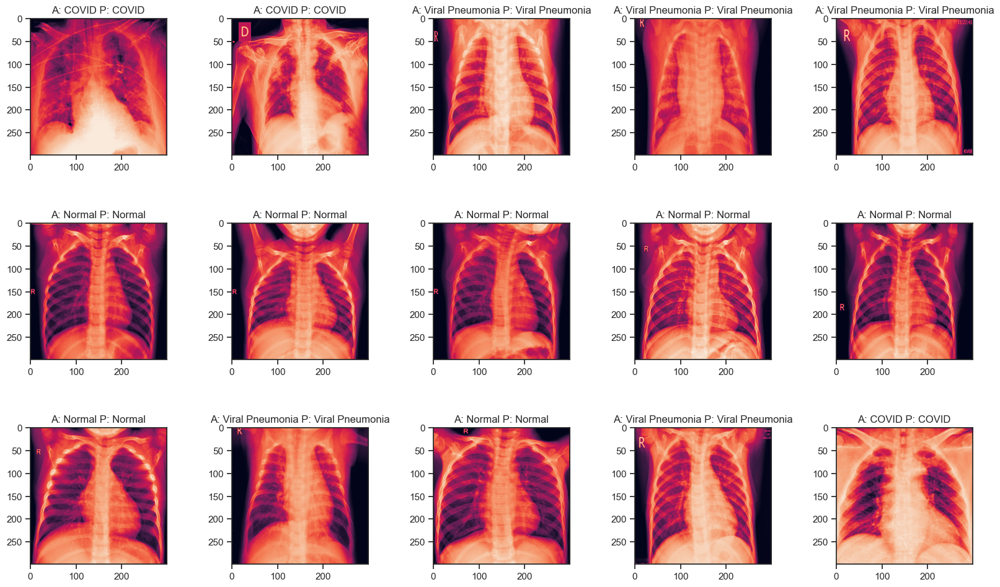

In [123]:
##################################
# Display sample images with matched
# actual and predicted categories
##################################
display_images(test_gen_df[test_gen_df['Matched_Category_Prediction']==True])

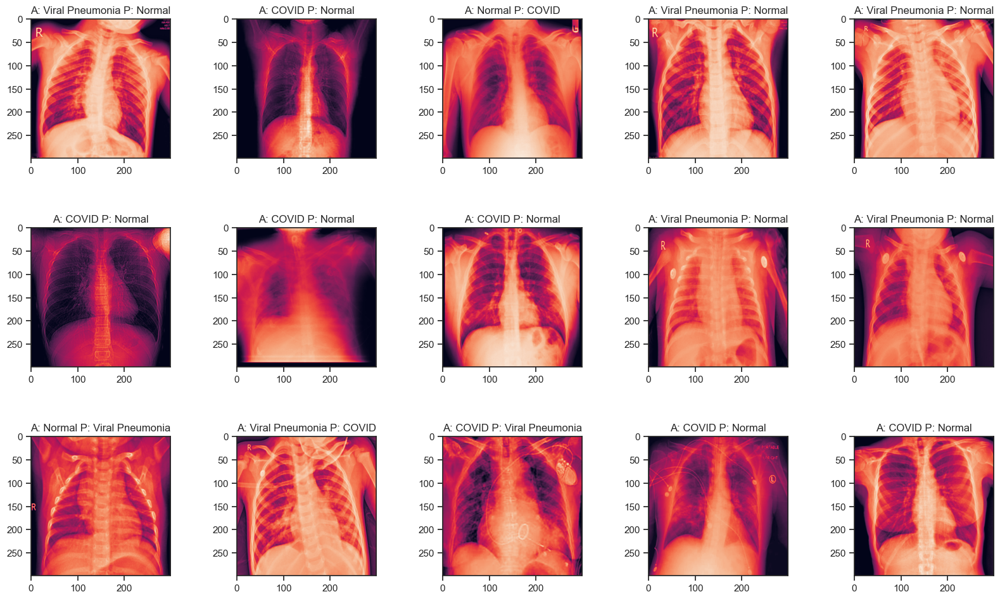

In [124]:
##################################
# Display sample images with mismatched
# actual and predicted categories
##################################
display_images(test_gen_df[test_gen_df['Matched_Category_Prediction']!=True])

In [125]:
##################################
# Recreating the CNN model defined as
# CNN with dropout regularization
# using the Functional API structure
##################################

##################################
# Defining the input layer
##################################
fmodel_input_layer = Input(shape=(299, 299, 1), name="input_layer")

##################################
# Using the layers from the Sequential model
# as functions in the Functional API
##################################
set_seed()
fmodel_conv2d_layer = model_dr.layers[0](fmodel_input_layer) # Conv2D layer
fmodel_maxpooling2d_layer = model_dr.layers[1](fmodel_conv2d_layer) # MaxPooling2D layer
fmodel_conv2d_1_layer = model_dr.layers[2](fmodel_maxpooling2d_layer) # Conv2D layer
fmodel_dropout_layer = model_dr.layers[3](fmodel_conv2d_1_layer) # Dropout layer
fmodel_maxpooling2d_1_layer = model_dr.layers[4](fmodel_dropout_layer) # MaxPooling2D layer
fmodel_flatten_layer = model_dr.layers[5](fmodel_maxpooling2d_1_layer) # Flatten layer
fmodel_dense_layer = model_dr.layers[6](fmodel_flatten_layer) # Dense layer (128 units)
fmodel_output_layer = model_dr.layers[7](fmodel_dense_layer) # Dense layer (num_classes units)

##################################
# Creating the Functional API model
##################################
model_dr_functional_api = Model(inputs=fmodel_input_layer, outputs=fmodel_output_layer, name="model_dr_fapi")

##################################
# Compiling the Functional API model
# with the same parameters
##################################
set_seed()
model_dr_functional_api.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=[Recall()])

##################################
# Displaying the model summary
# for CNN with dropout regularization
##################################
print(model_dr_functional_api.summary())

Model: "model_dr_fapi"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 299, 299, 1)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 299, 299, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 149, 149, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 149, 149, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 149, 149, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 74, 74, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 350464)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      44,859,520 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 3)                   │             387 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 44,878,723 (171.20 MB)

 Trainable params: 44,878,723 (171.20 MB)

 Non-trainable params: 0 (0.00 B)

None


In [126]:
##################################
# Creating a gradient model for the
# gradient class activation map
# of the first convolutional layer
##################################
grad_model_first_conv2d = Model(inputs=fmodel_input_layer, outputs=[fmodel_conv2d_layer, fmodel_output_layer], name="model_dr_fapi_first_conv2d")
set_seed()
grad_model_first_conv2d.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=[Recall()])

In [127]:
##################################
# Defining a function
# to formulate the gradient class activation map
# from the output of the first convolutional layer
##################################
def make_gradcam_heatmap(img_array, pred_index=None):
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model_first_conv2d(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy(), preds

In [128]:
##################################
# Defining a function
# to colorize the generated heatmap
# and superimpose on the actual image
##################################
def gradCAMImage(image):
    path = (os.path.join("..", DATASETS_ORIGINAL_PATH, image))
    img = readImage(path)
    img = np.expand_dims(img,axis=0)
    heatmap, preds = make_gradcam_heatmap(img)

    img = load_img(path)
    img = img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = plt.colormaps["turbo"]

    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * 0.80 + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)
    
    return superimposed_img

In [129]:
##################################
# Defining a function to consolidate
# the gradient class activation maps
# for a subset of sampled images
##################################
def gradcam_of_images(correct_class):
    grad_images = []
    title = []
    temp_df = test_gen_df[test_gen_df['Matched_Category_Prediction']==correct_class]
    temp_df = temp_df.reset_index(drop=True)
    for i in range(15):
        image = temp_df.FileName[i]
        grad_image = gradCAMImage(image)
        grad_images.append(grad_image)
        title.append(f"A: {temp_df.Actual_Category[i]} P: {temp_df.Predicted_Category[i]}")

    return grad_images, title

In [130]:
##################################
# Consolidating the gradient class activation maps
# from the output of the first convolutional layer
# for the subset of sampled images
# with matched actual and predicted categories
##################################
matched_categories, matched_categories_titles = gradcam_of_images(correct_class=True)

In [131]:
##################################
# Consolidating the gradient class activation maps
# from the output of the first convolutional layer
# for the subset of sampled images
# with mismatched actual and predicted categories
##################################
mismatched_categories, mismatched_categories_titles = gradcam_of_images(correct_class=False)

In [132]:
##################################
# Defining a function to display
# the consolidated gradient class activation maps
# for a subset of sampled images
##################################
def display_heatmaps(classified_images, titles):
    plt.figure(figsize = (20 , 20))
    n = 0
    for i in range(15):
        n+=1
        plt.subplot(5 , 5, n)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
        plt.imshow(classified_images[i])
        plt.title(titles[i])
    plt.show()

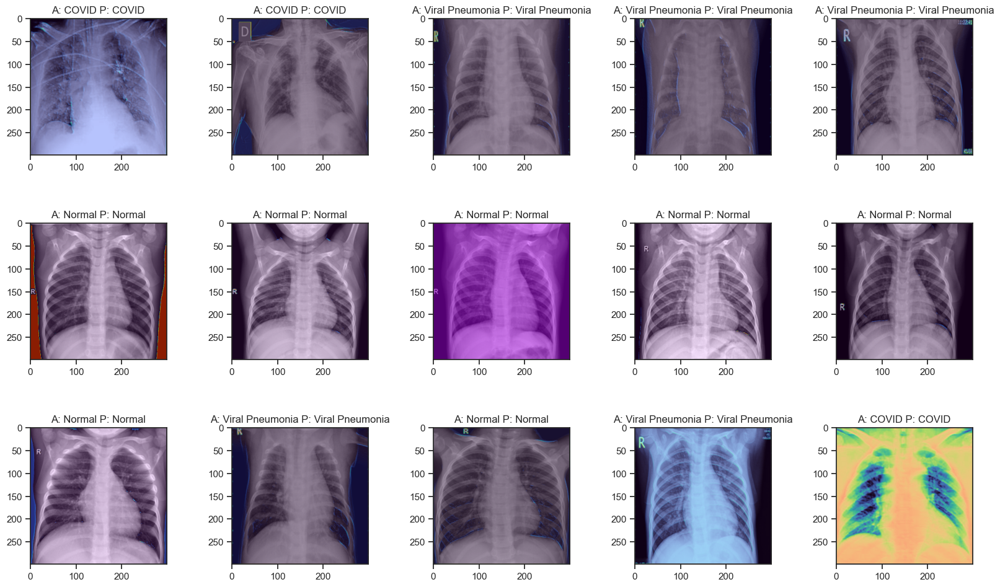

In [133]:
##################################
# Displaying the consolidated 
# gradient class activation maps
# from the output of the first convolutional layer
# for the subset of sampled images
# with matched actual and predicted categories
##################################
display_heatmaps(matched_categories, matched_categories_titles)

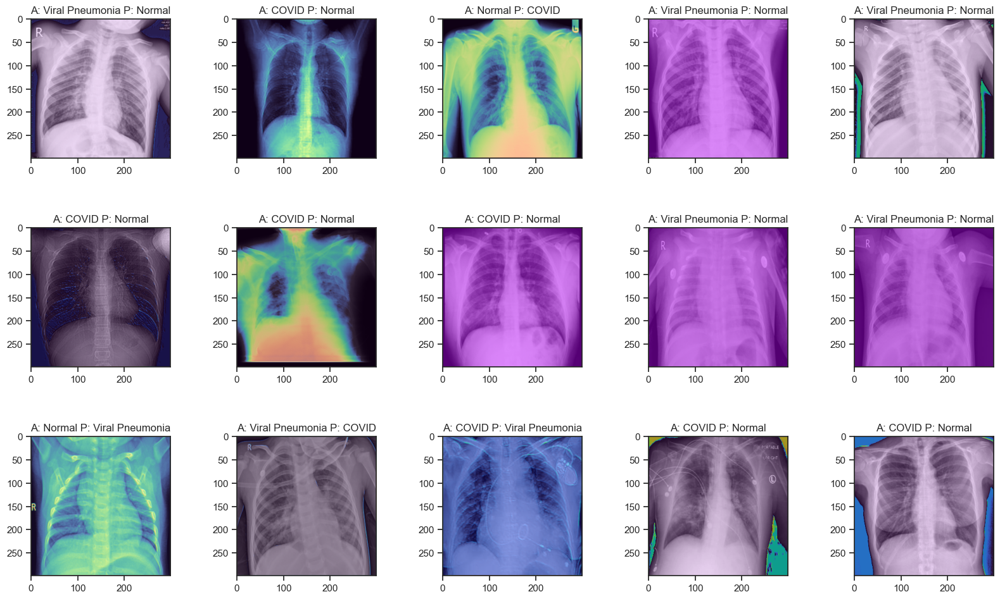

In [134]:
##################################
# Displaying the consolidated 
# gradient class activation maps
# from the output of the first convolutional layer
# for the subset of sampled images
# with mismatched actual and predicted categories
##################################
display_heatmaps(mismatched_categories, mismatched_categories_titles)

In [135]:
##################################
# Creating a gradient model for the
# gradient class activation map
# of the second convolutional layer
##################################
grad_model_second_conv2d = Model(inputs=fmodel_input_layer, outputs=[fmodel_conv2d_1_layer, fmodel_output_layer], name="model_dr_fapi_second_conv2d")
set_seed()
grad_model_second_conv2d.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=[Recall()])

In [136]:
##################################
# Defining a function
# to formulate the gradient class activation map
# from the output of the second convolutional layer
##################################
def make_gradcam_heatmap(img_array, pred_index=None):    
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model_second_conv2d(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy(), preds

In [137]:
##################################
# Consolidating the gradient class activation maps
# from the output of the second convolutional layer
# for the subset of sampled images
# with matched actual and predicted categories
##################################
matched_categories, matched_categories_titles = gradcam_of_images(correct_class=True)

In [138]:
##################################
# Consolidating the gradient class activation maps
# from the output of the second convolutional layer
# for the subset of sampled images
# with mismatched actual and predicted categories
##################################
mismatched_categories, mismatched_categories_titles = gradcam_of_images(correct_class=False)

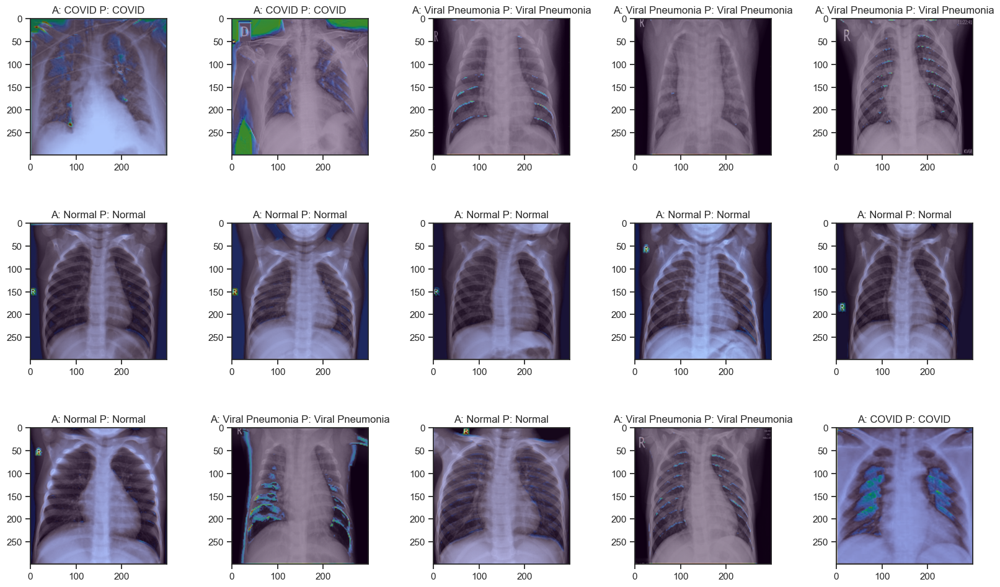

In [139]:
##################################
# Displaying the consolidated 
# gradient class activation maps
# from the output of the second convolutional layer
# for the subset of sampled images
# with matched actual and predicted categories
##################################
display_heatmaps(matched_categories, matched_categories_titles)

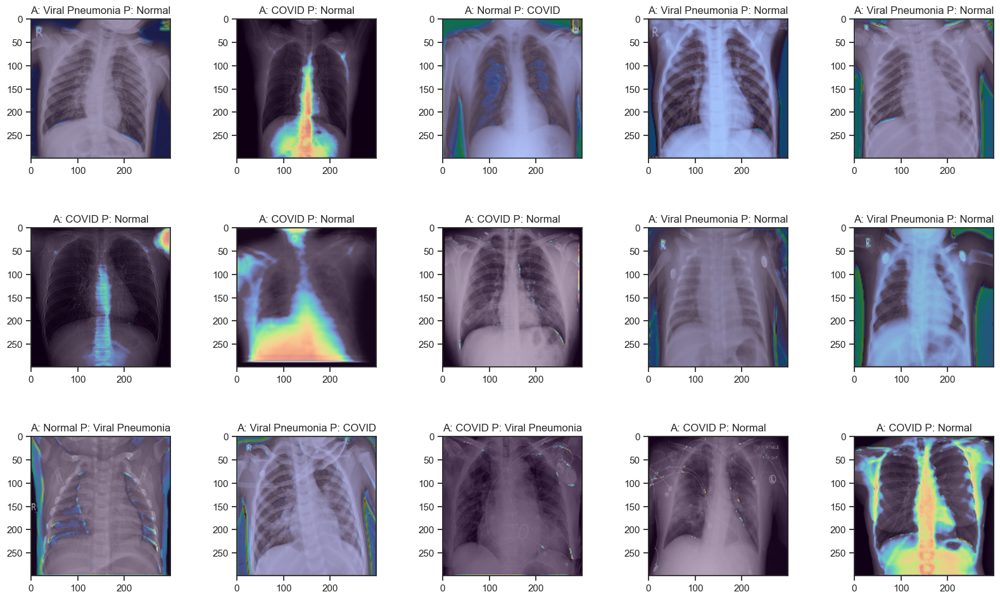

In [140]:
##################################
# Displaying the consolidated 
# gradient class activation maps
# from the output of the second convolutional layer
# for the subset of sampled images
# with mismatched actual and predicted categories
##################################
display_heatmaps(mismatched_categories, mismatched_categories_titles)

# 2. Summary <a class="anchor" id="Summary"></a>


**A convolutional neural network model applied with dropout regularization provided a set of robust and reliable predictions for classifying x-ray images into the normal, viral pneumonia, and COVID categories – predominantly characterized by low-level features including edges and textures; and mid to high-level features including shapes and patterns. The gradient-weighted class activation maps for  the convolutional layers highlighted image features that enabled the activation of the different image categories as follows:**

* **Normal**
    * **Clear lung fields**
    * **Clear bronchial structure**
* **Viral Pneumonia**
    * **Relatively patchy lung fields**
    * **Relatively visible bronchial structure**
* **COVID**
    * **Heavily patchy lung fields**
    * **Invisible bronchial structure**

**Overall, a convolutional neural network model architecture is particularly well-suited for learning the hierarchical features and spatial representations directly from raw pixel intensity data of X-ray images which sufficiently captured typical characteristics used in differentiating respiratory conditions in radiology and clinical imaging modalities. By leveraging automated feature extraction and enhanced sensitivity in identifying intricate spatial representations or subtle patterns representing abnormalities in images, convolutional neural network models can assist healthcare professionals in making more accurate diagnoses, enabling timely interventions, and ultimately improving patient outcomes in the management of respiratory conditions.**

* From an initial dataset comprised of 3600 grayscale images, an optimal subset of **7200 observations comprised of 3600 original images and 3600 augmented images** representing three image categories - **Normal**, **Viral Pneumonia** and **COVID** respiratory conditions were determined after conducting data quality assessment and applying preprocessing operations to improve generalization and reduce sensitivity to variations most suitable for the downstream analysis. Hierarchical features from the images were automatically and directly learned using the raw pixel data.

* Multiple convolutional neural network classification (CNN) models were developed with various combinations of regularization techniques namely, **Dropout** for preventing overfitting by randomly dropping out neurons during training, and **Batch Normalization** for standardizing the input of each layer to stabilize and accelerate training. **CNN With No Regularization**, **CNN With Dropout Regularization**, **CNN With Batch Normalization Regularization** and **CNN With Dropout and Batch Normalization Regularization** were formulated to discover hierarchical and spatial representations for image category prediction. Epoch training was optimized through internal resampling validation using **Split-Sample Holdout** with **F1 Score** used as the primary performance metric among **Precision** and **Recall**. All candidate models were compared based on internal and external validation performance.

* The final model selected among candidates used **CNN With Dropout Regularization** defined by 44,878,979 parameters and 8 sequential layers composed of the following: **Conv2D**: Filters=32, Kernel Size=3x3, Activation=RELU, Padding=Same; **Max_Pooling2D**: Pool Size=2x2, **Conv2D**: Filters=64, Kernel Size=3x3, Activation=RELU, Padding=Same; **Dropout**: Rate=0.25; **Max_Pooling2D**: Pool Size=2x2; **Flatten**; **Dense**: Units=128, Activation=RELU; and **Dense**: Units=3, Activation=SOFTMAX.
    
* The final model demonstrated the best externally validated F1 Score determined for all (**F1 Score=0.92, Precision=0.92, Recall=0.92**) and the individual image categories - normal (**F1 Score=0.91, Precision=0.87, Recall=0.97**), viral pneumonia (**F1 Score=0.92, Precision=0.95, Recall=0.90**) and COVID (**F1 Score=0.93, Precision=0.96, Recall=0.90**).

* Post-hoc exploration of the model results involved **Convolutional Layer Filter Visualization** and **Gradient Class Activation Mapping** methods. Both methods highlighted low-level and high-level image and object features that lead to the activation of the different image categories. These results helped provide insights on the important hierarchical and spatial representations for image category differentiation and model prediction.

**The current results have limitations which can be further addressed by extending the study to include the following actions:**
* Conducting model hyperparameter tuning given sufficient analysis time and higher computing power
* Formulating deeper neural network architectures to better capture spatial hierarchies and features in the input images
* Applying various techniques to interpret the CNN models by understanding and visualizing the features and decisions made at each layer
* Considering an imbalanced dataset and applying remedial measures to address unbalanced classification to accurately reflect real-world scenario
* Including a separate test subset for an independent evaluation of the tuned model


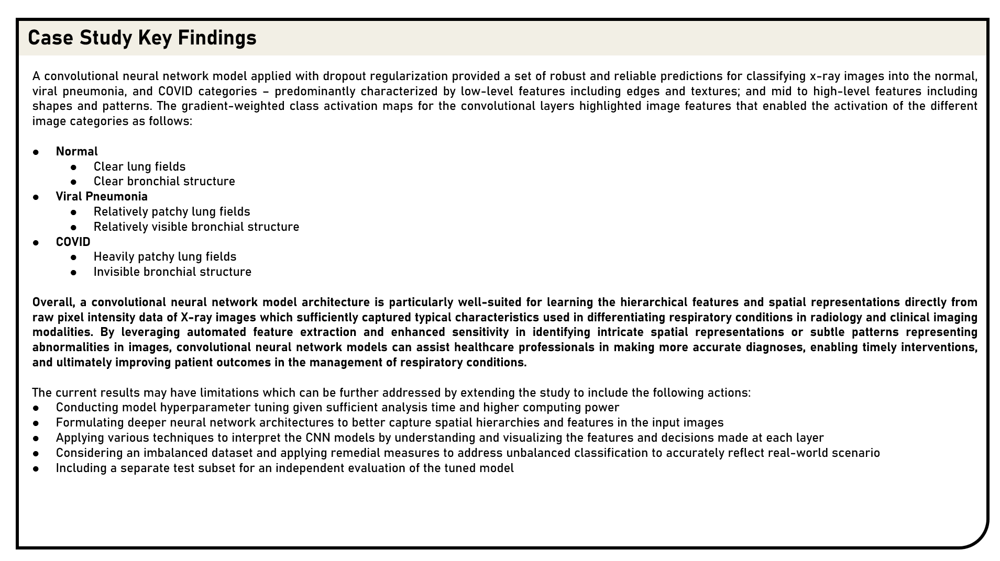

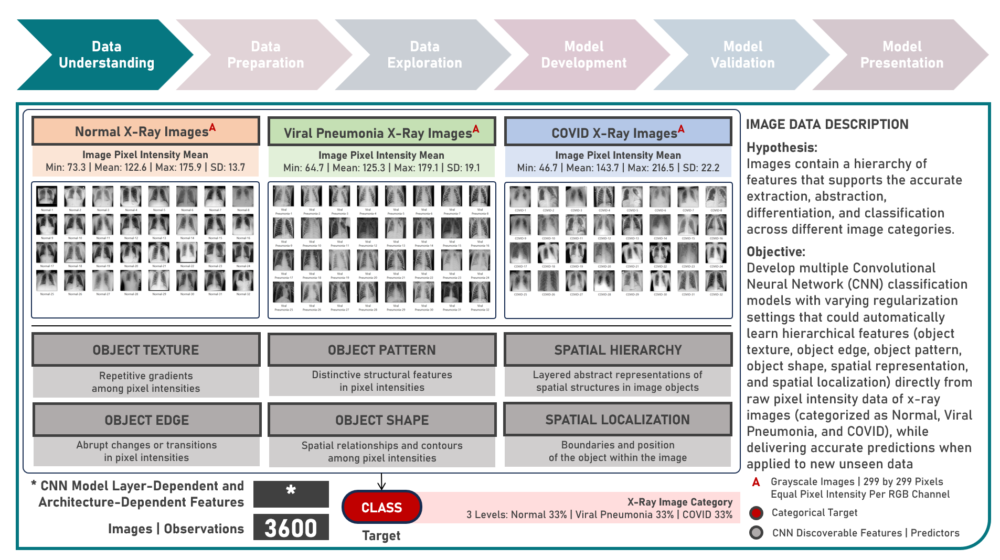

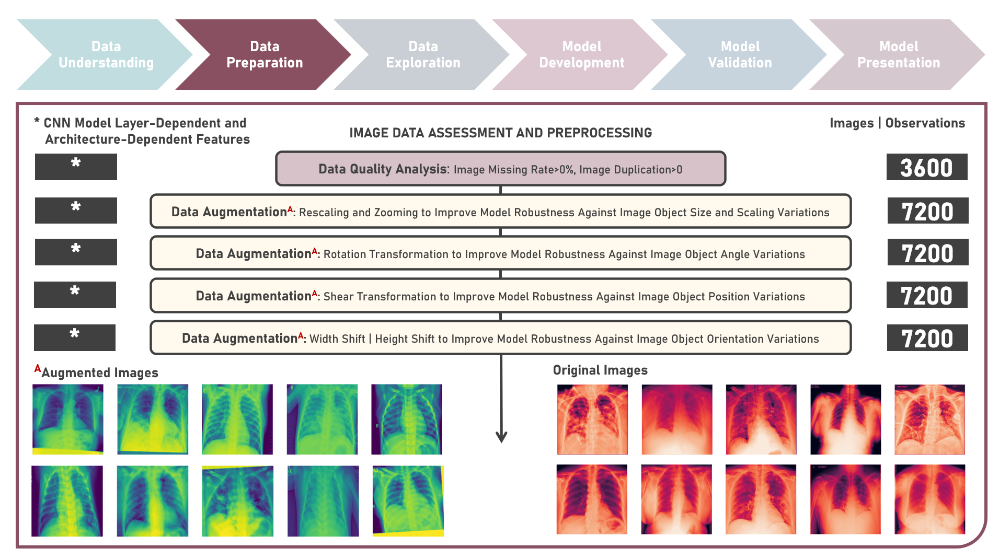

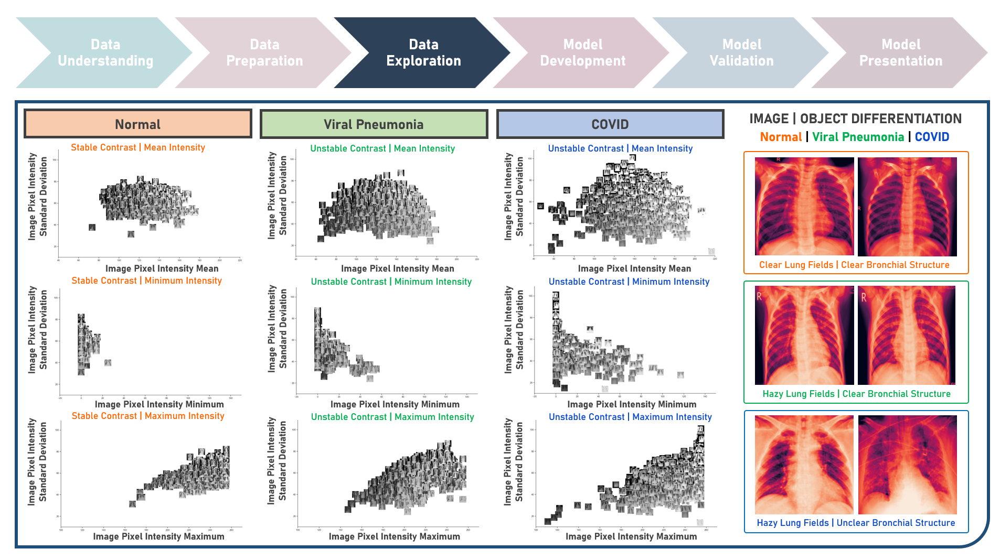

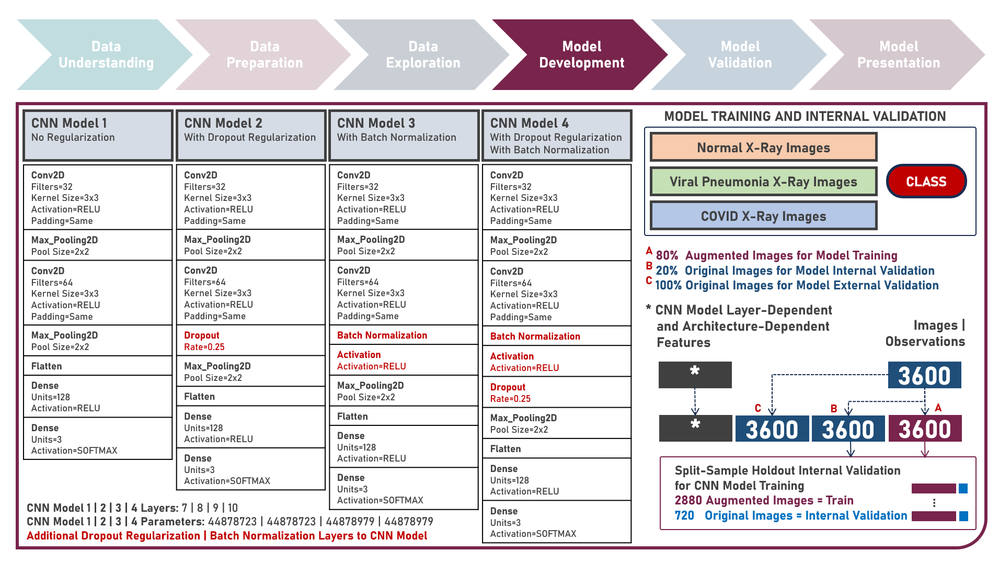

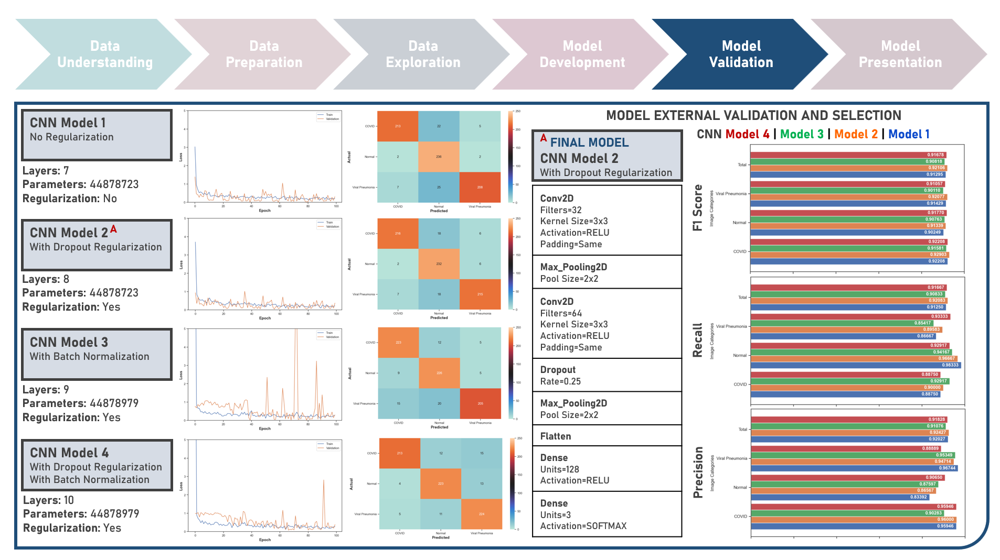

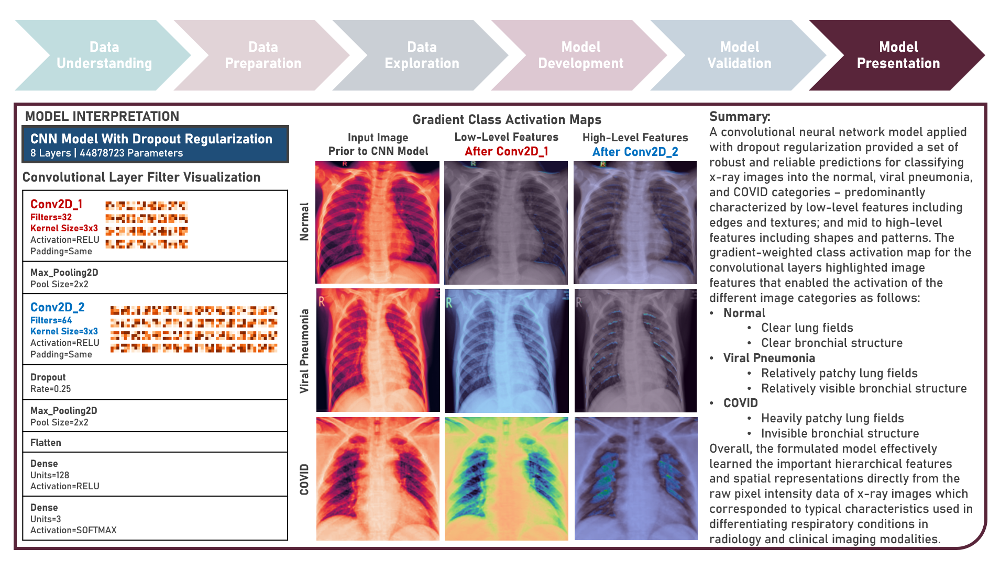

# 3. References <a class="anchor" id="References"></a>
* **[Book]** [Deep Learning with Python](https://www.manning.com/books/deep-learning-with-python) by Francois Chollet
* **[Book]** [Deep Learning: A Visual Approach](https://nostarch.com/deep-learning-visual-approach) by Andrew Glassner
* **[Book]** [Learning Deep Learning](https://ldlbook.com/) by Magnus Ekman
* **[Book]** [Practical Deep Learning](https://nostarch.com/practical-deep-learning-python) by Ronald Kneusel
* **[Book]** [Deep Learning with Tensorflow and Keras](https://www.packtpub.com/product/deep-learning-with-tensorflow-and-keras-third-edition/9781803232911) by Amita Kapoor, Antonio Gulli and Sujit Pal
* **[Book]** [Deep Learning](https://mitpress.mit.edu/9780262537551/deep-learning/) by John Kelleher
* **[Book]** [Generative Deep Learning](https://www.oreilly.com/library/view/generative-deep-learning/9781098134174/) by David Foster
* **[Book]** [Deep Learning Illustrated](https://www.deeplearningillustrated.com/) by John Krohn, Grant Beyleveld and Aglae Bassens
* **[Book]** [Neural Networks and Deep Learning](https://link.springer.com/book/10.1007/978-3-319-94463-0) by Charu Aggarwal
* **[Book]** [Grokking Deep Learning](https://www.manning.com/books/grokking-deep-learning) by Andrew Trask
* **[Book]** [Deep Learning with Pytorch](https://www.manning.com/books/deep-learning-with-pytorch) by Eli Stevens, Luca Antiga and Thomas Viehmann
* **[Book]** [Deep Learning](https://www.deeplearningbook.org/) by Ian Goodfellow, Yoshua Bengio and Aaron Courville
* **[Book]** [Deep Learning from Scratch](https://www.oreilly.com/library/view/deep-learning-from/9781492041405/) by Seth Weidman
* **[Book]** [Fundamentals of Deep Learning](https://www.oreilly.com/library/view/fundamentals-of-deep/9781492082170/) by Nithin Buduma, Nikhil Buduma and Joe Papa
* **[Book]** [Hands-On Machine Learning with Scikit-Learn, Keras and Tensorflow](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/) by Aurelien Geron
* **[Book]** [Deep Learning for Computer Vision](https://machinelearningmastery.com/deep-learning-for-computer-vision/) by Jason Brownlee
* **[Python Library API]** [numpy](https://numpy.org/doc/) by NumPy Team
* **[Python Library API]** [pandas](https://pandas.pydata.org/docs/) by Pandas Team
* **[Python Library API]** [seaborn](https://seaborn.pydata.org/) by Seaborn Team
* **[Python Library API]** [matplotlib.pyplot](https://matplotlib.org/3.5.3/api/_as_gen/matplotlib.pyplot.html) by MatPlotLib Team
* **[Python Library API]** [matplotlib.image](https://matplotlib.org/stable/api/image_api.html) by MatPlotLib Team
* **[Python Library API]** [matplotlib.offsetbox](https://matplotlib.org/stable/api/offsetbox_api.html) by MatPlotLib Team
* **[Python Library API]** [tensorflow](https://pypi.org/project/tensorflow/) by TensorFlow Team
* **[Python Library API]** [keras](https://pypi.org/project/keras/) by Keras Team
* **[Python Library API]** [pil](https://pypi.org/project/Pillow/) by Pillow Team
* **[Python Library API]** [glob](https://docs.python.org/3/library/glob.html) by glob Team
* **[Python Library API]** [cv2](https://pypi.org/project/opencv-python/) by OpenCV Team
* **[Python Library API]** [os](https://docs.python.org/3/library/os.html) by os Team
* **[Python Library API]** [random](https://docs.python.org/3/library/random.html) by random Team
* **[Python Library API]** [keras.models](https://www.tensorflow.org/api_docs/python/tf/keras/models) by TensorFlow Team
* **[Python Library API]** [keras.layers](https://www.tensorflow.org/api_docs/python/tf/keras/layers) by TensorFlow Team
* **[Python Library API]** [keras.wrappers](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Wrapper) by TensorFlow Team
* **[Python Library API]** [keras.utils](https://www.tensorflow.org/api_docs/python/tf/keras/utils) by TensorFlow Team
* **[Python Library API]** [keras.optimizers](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers) by TensorFlow Team
* **[Python Library API]** [keras.preprocessing.image](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image) by TensorFlow Team
* **[Python Library API]** [keras.callbacks](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks) by TensorFlow Team
* **[Python Library API]** [keras.metrics](https://www.tensorflow.org/api_docs/python/tf/keras/metrics) by TensorFlow Team
* **[Python Library API]** [sklearn.metrics](https://scikit-learn.org/stable/modules/model_evaluation.html) by Scikit-Learn Team
* **[Article]** [Convolutional Neural Networks, Explained](https://towardsdatascience.com/convolutional-neural-networks-explained-9cc5188c4939) by Mayank Mishra (Towards Data Science)
* **[Article]** [A Comprehensive Guide to Convolutional Neural Networks — the ELI5 way](https://towardsdatascience.com/a-comprehensive-guide-to-convolutional-neural-networks-the-eli5-way-3bd2b1164a53) by Sumit Saha (Towards Data Science)
* **[Article]** [Understanding Convolutional Neural Networks: A Beginner’s Journey into the Architecture](https://medium.com/codex/understanding-convolutional-neural-networks-a-beginners-journey-into-the-architecture-aab30dface10) by Afaque Umer (Medium)
* **[Article]** [Introduction to Convolutional Neural Networks (CNN)](https://www.analyticsvidhya.com/blog/2021/05/convolutional-neural-networks-cnn/) by Manav Mandal (Analytics Vidhya)
* **[Article]** [What Are Convolutional Neural Networks?](https://www.ibm.com/topics/convolutional-neural-networks) by IBM Team (IBM)
* **[Article]** [What is CNN? A 5 Year Old guide to Convolutional Neural Network](https://medium.com/analytics-vidhya/what-is-cnn-a-5-year-old-guide-to-convolutional-neural-network-c9d0338c3bf7) by William Ong (Medium)
* **[Article]** [Convolutional Neural Network](https://deepai.org/machine-learning-glossary-and-terms/convolutional-neural-network) by Thomas Wood (DeepAI.Org)
* **[Article]** [How Do Convolutional Layers Work in Deep Learning Neural Networks?](https://machinelearningmastery.com/convolutional-layers-for-deep-learning-neural-networks/) by Jason Brownlee (Machine Learning Mastery)
* **[Article]** [Convolutional Neural Networks Explained: Using PyTorch to Understand CNNs](https://builtin.com/data-science/convolutional-neural-networks-explained) by Vihar Kurama (BuiltIn)
* **[Article]** [Convolutional Neural Networks Cheatsheet](https://stanford.edu/~shervine/teaching/cs-230/cheatsheet-convolutional-neural-networks) by Afshine Amidi and Shervine Amidi (Stanford University)
* **[Article]** [An Intuitive Explanation of Convolutional Neural Networks](https://ujjwalkarn.me/2016/08/11/intuitive-explanation-convnets/) by Ujjwal Karn (The Data Science Blog)
* **[Article]** [Convolutional Neural Network](https://www.nvidia.com/en-us/glossary/data-science/convolutional-neural-network/) by NVIDIA Team (NVIDIA)
* **[Article]** [Convolutional Neural Networks (CNN) Overview](https://encord.com/blog/convolutional-neural-networks-explained/) by Nikolaj Buhl (Encord)
* **[Article]** [Understanding Convolutional Neural Network (CNN): A Complete Guide](https://learnopencv.com/understanding-convolutional-neural-networks-cnn/) by LearnOpenCV Team (LearnOpenCV)
* **[Article]** [Convolutional Neural Networks (CNNs) and Layer Types](https://pyimagesearch.com/2021/05/14/convolutional-neural-networks-cnns-and-layer-types/) by Adrian Rosebrock (PyImageSearch)
* **[Article]** [How Convolutional Neural Networks See The World](https://blog.keras.io/how-convolutional-neural-networks-see-the-world.html) by Francois Chollet (The Keras Blog)
* **[Article]** [What Is a Convolutional Neural Network?](https://www.mathworks.com/discovery/convolutional-neural-network-matlab.html#:~:text=A%20convolutional%20neural%20network%20(CNN,%2Dseries%2C%20and%20signal%20data.) by MathWorks Team (MathWorks)
* **[Article]** [Grad-CAM Class Activation Visualization](https://keras.io/examples/vision/grad_cam/) by Francois Chollet (Keras.IO)
* **[Article]** [Grad-CAM: Visualize Class Activation Maps with Keras, TensorFlow, and Deep Learning](https://pyimagesearch.com/2020/03/09/grad-cam-visualize-class-activation-maps-with-keras-tensorflow-and-deep-learning/) by Adrian Rosebrock (PyImageSearch)
* **[Kaggle Project]** [Covid 19 Radiography Data - EDA and CNN Model](https://www.kaggle.com/code/jnegrini/covid-19-radiography-data-eda-and-cnn-model) by Juliana Negrini De Araujo (Kaggle)
* **[Kaggle Project]** [Pneumonia Detection using CNN (92.6% Accuracy)](https://www.kaggle.com/code/madz2000/pneumonia-detection-using-cnn-92-6-accuracy) by Madhav Mathur (Kaggle)
* **[Kaggle Project]** [COVID Detection from CXR Using Explainable CNN](https://www.kaggle.com/code/sid321axn/covid-detection-from-cxr-using-explainable-cnn) by Manu Siddhartha (Kaggle)
* **[Kaggle Project]** [Class Activation Mapping for COVID-19 CNN](https://www.kaggle.com/code/amyjang/class-activation-mapping-for-covid-19-cnn) by Amy Zhang (Kaggle)
* **[Kaggle Project]** [CNN XRay COVID Classification](https://www.kaggle.com/code/gabrielmino/cnn-xray-covid-classification) by Gabriel Mino (Kaggle)
* **[Kaggle Project]** [Detecting-Covid-19-Images | CNN](https://www.kaggle.com/code/felipeoliveiraml/detecting-covid-19-images-cnn) by Felipe Oliveira (Kaggle)
* **[Kaggle Project]** [Detection of Covid Positive Cases using DL](https://www.kaggle.com/code/sana306/detection-of-covid-positive-cases-using-dl) by Sana Shaikh (Kaggle)
* **[Kaggle Project]** [Deep Learning and Transfer Learning on COVID-19](https://www.kaggle.com/code/digvijayyadav/deep-learning-and-transfer-learning-on-covid-19) by Digvijay Yadav (Kaggle)
* **[Kaggle Project]** [X-ray Detecting Using CNN](https://www.kaggle.com/code/shivan118/x-ray-detecting-using-cnn) by Shivan Kumar (Kaggle)
* **[Kaggle Project]** [Classification of COVID-19 using CNN](https://www.kaggle.com/code/islamselim/classification-of-covid-19-using-cnn) by Islam Selim (Kaggle)
* **[Kaggle Project]** [COVID-19 - Revisiting Pneumonia Detection](https://www.kaggle.com/code/pcbreviglieri/covid-19-revisiting-pneumonia-detection) by Paulo Breviglieri (Kaggle)
* **[Kaggle Project]** [Multi-Class X-ray Covid19 Classification-94% Accurary](https://www.kaggle.com/code/derrelldsouza/multi-class-x-ray-covid19-classification-94-acc) by Quadeer Shaikh (Kaggle)
* **[Kaggle Project]** [Grad-CAM: What Do CNNs See?](https://www.kaggle.com/code/quadeer15sh/grad-cam-what-do-cnns-see) by Derrel Souza (Kaggle)
* **[GitHub Project]** [Grad-CAM](https://github.com/ismailuddin/gradcam-tensorflow-2/blob/master/notebooks/GradCam.ipynb) by Ismail Uddin (GitHub)
* **[Publication]** [Gradient-Based Learning Applied to Document Recognition](https://ieeexplore.ieee.org/document/726791) by Yann LeCun, Leon Bottou, Yoshua Bengio and Patrick Haffner (Proceedings of the IEEE)
* **[Publication]** [Learning Deep Features for Discriminative Localization](https://arxiv.org/abs/1512.04150) by Bolei Zhou, Aditya Khosla, Agata Lapedriza, Aude Oliva and Antonio Torralba (Computer Vision and Pattern Recognition)
* **[Publication]** [Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization](https://arxiv.org/abs/1610.02391) by Ramprasaath Selvaraju, Michael Cogswell, Abhishek Das, Ramakrishna Vedantam, Devi Parikh and Dhruv Batra (Computer Vision and Pattern Recognition)
* **[Course]** [IBM Data Analyst Professional Certificate](https://www.coursera.org/professional-certificates/ibm-data-analyst) by IBM Team (Coursera)
* **[Course]** [IBM Data Science Professional Certificate](https://www.coursera.org/professional-certificates/ibm-data-science) by IBM Team (Coursera)
* **[Course]** [IBM Machine Learning Professional Certificate](https://www.coursera.org/professional-certificates/ibm-machine-learning) by IBM Team (Coursera)


In [141]:
from IPython.display import display, HTML
display(HTML("<style>.rendered_html { font-size: 15px; font-family: 'Trebuchet MS'; }</style>"))

***